# Lab 3

__Team Members__
- Name 1: Jorge Olmos
- Name 2: Bosang Yun
- Name 3: Yucheol Shin
- Name 4: Siu Wai Yeung

# Content
* [Business Understanding](#business-understanding)
* [Data Understanding](#data-understanding)
    - [Part 1](#data-understanding-part1)
    - [Part 2](#data-understanding-part2)
* [Modeling Evaluation](#deployment)
    - [Train and Adjust Parameters](#train-adjust)
    - [Evaluate and Compare](#evaluate-compare)
    - [Visualize Resutls](#visualize-results)
    - [Summarize Rammifications](#summarize-rammifications)
* [Deployment](#deployment)
* [Exceptional Work](#exceptional-work)

In [1]:
import pandas as pd
import numpy as np

hotel_bookings = pd.read_csv('https://raw.githubusercontent.com/olmosjorge28/DS7331_ML1_ASSINGMENTS/main/hotel_bookings.csv') # read in the csv file
hotel_bookings.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,7/1/15
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,7/1/15
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,7/2/15
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,7/2/15
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,7/3/15


In [3]:
import math
from datetime import date


hotel_bookings_transform = hotel_bookings
# removing 'agent','company' and 'country'
hotel_bookings_transform= hotel_bookings_transform.drop(columns=['agent','company', 'country'])

# For the remainder they appear to have been omitted accidentally and we decided to populate the missing values with the mode.
hotel_bookings[['children','country','market_segment','meal','distribution_channel']].mode() 


hotel_bookings_transform['meal']= hotel_bookings_transform['meal'].apply(lambda x: 'SC' if  x == 'Undefined'  else x)
hotel_bookings_transform['children']= hotel_bookings_transform['children'].apply(lambda x: 0 if  math.isnan(x)  else x)
hotel_bookings_transform['market_segment']= hotel_bookings_transform['market_segment'].apply(lambda x: 'Online TA' if  x == 'Undefined'  else x)
hotel_bookings_transform['distribution_channel']= hotel_bookings_transform['distribution_channel'].apply(lambda x: 'TA/TO' if  x == 'Undefined'  else x)

In [4]:
# Encoding process

hotel_bookings_transform['hotel']=hotel_bookings_transform['hotel'].astype('category').cat.codes
hotel_bookings_transform['market_segment']=hotel_bookings_transform['market_segment'].astype('category').cat.codes
hotel_bookings_transform['meal']=hotel_bookings_transform['meal'].astype('category').cat.codes
hotel_bookings_transform['reservation_status']=hotel_bookings_transform['reservation_status'].astype('category').cat.codes
hotel_bookings_transform['distribution_channel']=hotel_bookings_transform['distribution_channel'].astype('category').cat.codes
hotel_bookings_transform['reserved_room_type']=hotel_bookings_transform['reserved_room_type'].astype('category').cat.codes
hotel_bookings_transform['assigned_room_type']=hotel_bookings_transform['assigned_room_type'].astype('category').cat.codes
hotel_bookings_transform['deposit_type']=hotel_bookings_transform['deposit_type'].astype('category').cat.codes
hotel_bookings_transform['customer_type']=hotel_bookings_transform['customer_type'].astype('category').cat.codes

assign_month = {"arrival_date_month": {"January": 1, "February": 2, "March": 3, "April": 4,"May": 5,"June": 6,"July": 7,"August": 8,"September": 9,"October": 10,"November": 11,"December": 12}}
hotel_bookings_transform = hotel_bookings_transform.replace(assign_month)

# Convert Date to Ordinal
import datetime as dt
hotel_bookings_transform['reservation_status_date'] = pd.to_datetime(hotel_bookings_transform['reservation_status_date'])
hotel_bookings_transform['reservation_status_date'] = hotel_bookings_transform['reservation_status_date'].map(dt.datetime.toordinal)

hotel_bookings_transform=hotel_bookings_transform.assign(booking_day_of_year = hotel_bookings_transform["arrival_date_year"].astype(str) + '-' + 
hotel_bookings_transform["arrival_date_month"].astype(str) + '-' +hotel_bookings_transform["arrival_date_day_of_month"].astype(str))
hotel_bookings_transform['booking_day_of_year']=pd.to_datetime(hotel_bookings_transform.booking_day_of_year)
hotel_bookings_transform['booking_day_of_year']=hotel_bookings_transform['booking_day_of_year'].map(lambda x: x.toordinal() - date(x.year, 1, 1).toordinal() + 1)


hotel_bookings_transform=hotel_bookings_transform.drop(columns=['arrival_date_year','reservation_status_date'])
#hotel_bookings_transform['booking_date']=hotel_bookings_transform['booking_date'].map(dt.datetime.toordinal)

# 1. Business Understanding  <a id='business-understanding'/>

## `Purpose of Data Selected`

## `How will you measure the effectiveness of a good algorithm? `

## `Why does your chosen validation method make sense for this specific dataset and the stakeholders needs?`

# 2. Data Understanding <a id = '#data-understanding'/>

## Part 1 <a id ='#data-understanding-part1'/>

### `Describe the meaning and type of data (scale, values, etc.) for each attribute in the data file
&emsp; The full description of the data can be found in https://www.sciencedirect.com/science/article/pii/S2352340918315191:


| Variable | Type | Description | Source/Engineering |
| --- | --- | --- | --- |
| ADR | Numeric | Average Daily Rate as defined by | BO, BL and TR / Calculated by dividing the sum of all lodging transactions by the total number of staying nights |
| Adults | Integer | Number of adults | BO and BL |
| Agent | Categorical | ID of the travel agency that made the bookinga | BO and BL |
| ArrivalDateDayOfMonth | Integer | Day of the month of the arrival date | BO and BL |
| ArrivalDateMonth | Categorical | Month of arrival date with 12 categories: “January” to “December”| BO and BL |
| ArrivalDateWeekNumber	| Integer | Week number of the arrival date | BO and BL |
| ArrivalDateYear | Integer | Year of arrival date | BO and BL |
| AssignedRoomType | Categorical | Code for the type of room assigned to the booking. Sometimes the assigned room type differs from the reserved room type due to hotel operation reasons (e.g. overbooking) or by customer request. Code is presented instead of designation for anonymity reasons | BO and BL |
| Babies | Integer | Number of babies | BO and BL |
| BookingChanges | Integer | Number of changes/amendments made to the booking from the moment the booking was entered on the PMS until the moment of check-in or cancellation | BO and BL/Calculated by adding the number of unique iterations that change some of the booking attributes, namely: persons, arrival date, nights, reserved room type or meal |
| Children | Integer | Number of children | BO and BL/Sum of both payable and non-payable children |
| Company | Categorical | ID of the company/entity that made the booking or responsible for paying the booking. ID is presented instead of designation for anonymity reasons	BO and BL. |
| Country | Categorical | Country of origin. Categories are represented in the ISO 3155–3:2013 format [6] | BO, BL and NT |
| CustomerType | Categorical | Type of booking, assuming one of four categories: <br> Contract - when the booking has an allotment or other type of contract associated to it; <br> Group – when the booking is associated to a group; <br> Transient – when the booking is not part of a group or contract, and is not associated to other transient booking; <br> Transient-party – when the booking is transient, but is associated to at least other transient booking <br> | BO and BL |
| DaysInWaitingList | Integer | Number of days the booking was in the waiting list before it was confirmed to the customer | BO/Calculated by subtracting the date the booking was confirmed to the customer from the date the booking entered on the PMS |
| DepositType | Categorical | Indication on if the customer made a deposit to guarantee the booking. This variable can assume three categories: <br> No Deposit – no deposit was made; <br> Non Refund – a deposit was made in the value of the total stay cost; <br> Refundable – a deposit was made with a value under the total cost of stay. | BO and TR/Value calculated based on the payments identified for the booking in the transaction (TR) table before the booking׳s arrival or cancellation date. |
| DistributionChannel | Categorical | Booking distribution channel. The term “TA” means “Travel Agents” and “TO” means “Tour Operators” | BO, BL and DC |
| IsCanceled | Categorical | Value indicating if the booking was canceled (1) or not (0) | BO |
| IsRepeatedGuest | Categorical | Value indicating if the booking name was from a repeated guest (1) or not (0) | BO, BL and C/ Variable created by verifying if a profile was associated with the booking customer. If so, and if the customer profile creation date was prior to the creation date for the booking on the PMS database it was assumed the booking was from a repeated guest |
| LeadTime | Integer | Number of days that elapsed between the entering date of the booking into the PMS and the arrival date | BO and BL/ Subtraction of the entering date from the arrival date |
| MarketSegment | Categorical | Market segment designation. In categories, the term “TA” means “Travel Agents” and “TO” means “Tour Operators” | BO, BL and MS |
| Meal | Categorical | Type of meal booked. | Categories are presented in standard hospitality meal packages: <br> Undefined/SC – no meal package; <br> BB – Bed & Breakfast; <br> HB – Half board (breakfast and one other meal – usually dinner); <br> FB – Full board (breakfast, lunch and dinner) | BO, BL and ML |
| PreviousBookingsNotCanceled | Integer | Number of previous bookings not cancelled by the customer prior to the current booking | BO and BL / In case there was no customer profile associated with the booking, the value is set to 0. Otherwise, the value is the number of bookings with the same customer profile created before the current booking and not canceled. |
| PreviousCancellations | Integer | Number of previous bookings that were cancelled by the customer prior to the current booking | BO and BL/ In case there was no customer profile associated with the booking, the value is set to 0. Otherwise, the value is the number of bookings with the same customer profile created before the current booking and canceled. |
| RequiredCardParkingSpaces | Integer | Number of car parking spaces required by the customer | BO and BL |
| ReservationStatus | Categorical | Reservation last status, assuming one of three categories: <br> Canceled – booking was canceled by the customer; <br> Check-Out – customer has checked in but already departed; <br> No-Show – customer did not check-in and did inform the hotel of the reason why | BO |
| ReservationStatusDate | Date | Date at which the last status was set. This variable can be used in conjunction with the ReservationStatus to understand when was the booking canceled or when did the customer checked-out of the hotel | BO |
| ReservedRoomType | Categorical | Code of room type reserved. Code is presented instead of designation for anonymity reasons | BO and BL |
| StaysInWeekendNights | Integer | Number of weekend nights (Saturday or Sunday) the guest stayed or booked to stay at the hotel | BO and BL/ Calculated by counting the number of weekend nights from the total number of nights |
| StaysInWeekNights | Integer | Number of week nights (Monday to Friday) the guest stayed or booked to stay at the hotel | BO and BL/Calculated by counting the number of week nights from the total number of nights |
| TotalOfSpecialRequests | Integer | Number of special requests made by the customer (e.g. twin bed or high floor) | BO and BL/Sum of all special requests |
<br>





### `Verify data quality`

#### `Missing values?`
Upon initial inspection of the 31 attributes, we noticed the following,
1. Total of 7 attributes appears to have some missing data.
We decided to replace the missing value “__nan__ and “__Undefined__” with __MODE__ as they appear to be accidental
2. We decided to __remove__ “__agent__” and “__company__” attributes as they do not provide any valuable information for analysis
3. we decided to replace '__Undefined__' with '__SC__' under Meal attribute as they are synonymous. 
4. We classify the non-categorical attributes that are above and below 1.5 times the interquartile range of the dataset as __outliers__. 

Below is a list of all the attributes with missing values and the counts:
* agent- 16340
* company- 112593
* children- 4
* country- 488
* market_segment - 2
* meal - 1169
* distribution_channel – 5

There's an association between the distribution channel type and the agent and company attributes. 
1. If the distribution channel is from a Traveling Agent (__TA__) or Tour Operator (__TO__), then the agency company is supplied in the agent column. 
2. if the distribution channel is __Corporate__, then the company associated with the booking is populated under the company attribute. 
3. If the distribution is neither __Corporate__, __TA__ or __TO__ than both the __agent and company__ attributes will be __null__. 
4. For the meal attribute during our data investigation, we have found out that '__Undefined__' and '__SC__' are synonymous so we have decided to __replace__ '__Undefined__' with '__SC__'. 


To simplify our data exploration, we decided to __remove__ the __agent and company__ attributes as they don't provide any additional information beyond what already is provided in the distribution channel. 
Data cleaning for the above attributes will be followed. 

#### `Outliers`
##### Outlier removal
- First we decided to take a look the simple statistics of the continuous variables to see if they make sense. 
- __adr__ and __lead_time__ had minimum and maximum values that appear as data entry error.  
- __stays_in_week_nights__ and __stays_in_weekend_nights__ had too extreme maximum values when there are only seven days in a week. 
- __days_in_waiting_list__, __total_of_special_requests__ and __required_car_parking_spaces__ had reasonable data distribution. 
- After determining that the 4 continuous features(adr, lead_time, stays_week_nights, stays_weekend_nights) have extreme outliers, the 25% and 75% interquartile range (IQR) was utilized in order to identify and remove the outliers from the dataset. 
- Outliers that are positioned at above and below the 1.5 times the upper and lower limit of IQR are removed

# 3. Modeling and Evaluation

In [2]:
from rpy2.robjects.packages import importr
from rpy2 import robjects as robj

%matplotlib inline

# this way we can write r code by simply writing %R
%load_ext rmagic
%load_ext rpy2.ipython 
# this enables the %R extension to iPython (does not work outside of the iPython shell)

# these packages will need to be installed
# open R and run 
#     install.package(arules)
#     install.package(arulesViz)

arules = importr('arules') # same as importing in R with the "library" command
arules_viz = importr('arulesViz') # visualize the different rules

hotel_bookings_transform.to_csv('output.csv')

/opt/anaconda3/lib/python3.8/site-packages/IPython/extensions/rmagic.py:11: UserWarning: The rmagic extension in IPython has moved to `rpy2.ipython`, please see `rpy2` documentation.
  warnings.warn("The rmagic extension in IPython has moved to "


NameError: name 'hotel_bookings_transform' is not defined

In [ ]:
%R bookings <- read.csv("output.csv")
%R head(bookings)

%R bookings$is_canceled <- as.factor(bookings$is_canceled)

# Discretize lead_time and adr to (low, medium, high)
dfDisc <- discretizeDF(df, methods = list(lead_time = list(method = "frequency", breaks = 3, 
                                                           + labels = c("Low", "Medium", "High")),
                                                           + adr = list(method = "frequency", breaks = 3, 
                                                           +labels = c("Low", "Medium", "High"))),
                                                           +default = list(method = "none"))
%R head(dfDisc) 

%R dfDisc%>%group_by(adr)%>%count()
%R dfDisc%>%group_by(lead_time)%>%count()

## Train and adjust parameters

In [4]:
# getting things started
import time
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from rpy2.robjects.packages import importr
from rpy2 import robjects as robj


%matplotlib inline

%load_ext rmagic
%load_ext rpy2.ipython 

# %R arules = importr('arules') # same as importing in R with the "library" command
# %R arules_viz = importr('arulesViz') # visualize the different rules

# %R library('mlbench')

%R library(arules)


# convert to transactions, where column indicates the output of the attribute
%R trans <- as(bookings, "transactions")

# # Now that we have transactions, its time to run the apriori algorithm
%R isets <- apriori(trans, parameter=list(target="frequent", support=0.5))
# sort it and display some of the frequent itemsets from apriori
%R isets <- sort(isets, by="support") 
%R inspect(head(isets, n=100))
%R length(isets)

The rmagic extension is already loaded. To reload it, use:
  %reload_ext rmagic
The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython
Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
         NA    0.1    1 none FALSE            TRUE       5     0.5      1
 maxlen            target  ext
     10 frequent itemsets TRUE

Algorithmic control:
 filter tree heap memopt load sort verbose
    0.1 TRUE TRUE  FALSE TRUE    2    TRUE

Absolute minimum support count: 59695 

set item appearances ...[0 item(s)] done [0.00s].
set transactions ...[52 item(s), 119390 transaction(s)] done [0.27s].
sorting and recoding items ... [21 item(s)] done [0.02s].
creating transaction tree ... done [0.12s].
checking subsets of size 1 2 3 4 5 6 7 8 9 10 done [0.74s].
sorting transactions ... done [0.06s].
writing ... [233500 set(s)] done [0.18s].
creating S4 object  ... done [0.15s].
      items                       

       previous_cancellations=[0,26]}               1                        0 119390
[50]  {previous_cancellations=[0,26],                                                
       booking_changes=[0,21]}                      1                        0 119390
[51]  {distribution_channel=[0,3],                                                   
       is_repeated_guest=[0,1]}                     1                        0 119390
[52]  {is_repeated_guest=[0,1],                                                      
       deposit_type=[0,2]}                          1                        0 119390
[53]  {meal=[0,3],                                                                   
       is_repeated_guest=[0,1]}                     1                        0 119390
[54]  {babies=[0,10],                                                                
       is_repeated_guest=[0,1]}                     1                        0 119390
[55]  {children=[0,10],                               

[97]  {is_canceled=[0,1],                                                            
       days_in_waiting_list=[0,391]}                1                        0 119390
[98]  {hotel=[0,1],                                                                  
       days_in_waiting_list=[0,391]}                1                        0 119390
[99]  {booking_changes=[0,21],                                                       
       days_in_waiting_list=[0,391]}                1                        0 119390
[100] {is_canceled=[0,1],                                                            
       required_car_parking_spaces=[0,8]}           1                        0 119390


array([233500], dtype=int32)

## Evaluate and Compare

In [51]:
# Do same thing, getting only the maximal sets
%R is_max <- isets[is.maximal(isets)]
%R inspect(head(sort(is_max, by="support")))
%R length(is_max)

    items                                   support transIdenticalToItemsets  count
[1] {children=[0,10],                                                              
     babies=[0,10],                                                                
     meal=[0,3],                                                                   
     distribution_channel=[0,3],                                                   
     is_repeated_guest=[0,1],                                                      
     previous_cancellations=[0,26],                                                
     previous_bookings_not_canceled=[0,72],                                        
     reserved_room_type=[0,9],                                                     
     deposit_type=[0,2],                                                           
     days_in_waiting_list=[0,391]}                1                        0 119390
[2] {children=[0,10],                                                       

array([42471], dtype=int32)

In [12]:
%R rules <- apriori(trans, parameter=list(minlen=2 support=.5, confidence=.9), 
                    + control = list(verbose=F),
                    + appearance = list(rhs=c("is_canceled=0", "is_canceled=1"),
                    + default="lhs"))
#%R rules <- apriori( trans, list(minlen=1, supp=0.01, conf=0.01)

%R inspect(head(rules, n=100))

# print out measures of rule quality
%R quality(head(rules))

Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
        0.9    0.1    1 none FALSE            TRUE       5     0.5      1
 maxlen target  ext
     10  rules TRUE

Algorithmic control:
 filter tree heap memopt load sort verbose
    0.1 TRUE TRUE  FALSE TRUE    2    TRUE

Absolute minimum support count: 59695 

set item appearances ...[0 item(s)] done [0.00s].
set transactions ...[52 item(s), 119390 transaction(s)] done [0.27s].
sorting and recoding items ... [21 item(s)] done [0.02s].
creating transaction tree ... done [0.13s].
checking subsets of size 1 2 3 4 5 6 7 8 9 10 done [0.44s].
writing ... [1615673 rule(s)] done [0.92s].
creating S4 object  ... done [0.78s].
      lhs                                  rhs                                       support confidence  coverage      lift  count
[1]   {}                                => {customer_type=[2,3]}                   0.9610269  0.9610269 1.0000000 1.0000000 114737
[2]

[56]  {reservation_status=[1,2]}        => {days_in_waiting_list=[0,391]}          0.6396934  1.0000000 0.6396934 1.0000000  76373
[57]  {reservation_status=[1,2]}        => {required_car_parking_spaces=[0,8]}     0.6396934  1.0000000 0.6396934 1.0000000  76373
[58]  {reservation_status=[1,2]}        => {is_canceled=[0,1]}                     0.6396934  1.0000000 0.6396934 1.0000000  76373
[59]  {reservation_status=[1,2]}        => {hotel=[0,1]}                           0.6396934  1.0000000 0.6396934 1.0000000  76373
[60]  {reservation_status=[1,2]}        => {booking_changes=[0,21]}                0.6396934  1.0000000 0.6396934 1.0000000  76373
[61]  {assigned_room_type=[0,3)}        => {customer_type=[2,3]}                   0.6330095  0.9616241 0.6582712 1.0006214  75575
[62]  {assigned_room_type=[0,3)}        => {reserved_room_type=[0,9]}              0.6582712  1.0000000 0.6582712 1.0000000  78591
[63]  {assigned_room_type=[0,3)}        => {previous_bookings_not_canceled=[0,72]} 

,support,confidence,coverage,lift,count
1,0.961027,0.961027,1.0,1.0,114737
2,1.000000,1.000000,1.0,1.0,119390
3,1.000000,1.000000,1.0,1.0,119390
4,1.000000,1.000000,1.0,1.0,119390
5,1.000000,1.000000,1.0,1.0,119390
6,1.000000,1.000000,1.0,1.0,119390


In [9]:
# sort out the rules and print additional "interest" measures
%R rules <- sort(rules, by="lift")
%R inspect(head(rules, n=10))w
%R interestMeasure(rules[1:10], method=c("phi", "gini"), trans=trans)

RParsingError: Parsing status not OK - PARSING_STATUS.PARSE_ERROR

In [ ]:
#pruning

%R quality(rules) <- round(quality(rules), digits=3)
# Rules are sorted by lift to make high-lift rules appear first
%R rules.sorted <- sort(rules, by="lift")
%R inspect(rules.sorted)


          lhs                                        rhs                                     support confidence coverage  lift  count
[1]       {total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2]       {reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3]       {previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4]       {previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer

           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[27]      {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[28]      {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[47]      {previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[48]      {previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[49]      {is_canceled=[0,1],                                 

[67]      {distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[68]      {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[69]      {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                        

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[88]      {babies=[0,10],                                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[89]      {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           total_of_special_requests=[0,1)}       => {customer

           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[108]     {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[109]     {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[123]     {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                           67898
[124]     {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[139]     {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[140]     {distribution_channel=[0,3],                        

           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[158]     {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[159]     {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                          

[180]     {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[181]     {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[206]     {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[207]     {meal=[0,3],                                        

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[230]     {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                                                          
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[236]     {children=[0,10],                                    

           is_repeated_guest=[0,1],                                                                                                                                     
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[259]     {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[260]     {is_repeated_gues

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[285]     {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[286]     {babies=[0,10],                                     

[307]     {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[308]     {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {customer

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[330]     {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[331]     {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[354]     {distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[355]     {distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

[378]     {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589   required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[383]     {distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                  

[404]     {children=[0,10],                                                                                                          
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[405]     {deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[428]     {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[429]     {meal=[0,3],                                        

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[453]     {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[454]     {children=[0,10],                                                                                                          
           booking_changes=[0,21],                            

[476]     {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[477]     {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[494]     {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[495]     {children=[0,10],                                                                                                          
                                                              

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                         babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[517]     {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           r

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[536]     {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[554]     {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[573]     {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[592]     {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[593]     {meal=[0,3],                                        

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[611]     {meal=[0,3],                                                                                                                     0.966    0.589 1.005  67898
[615]     {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0

[632]     {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[633]     {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[652]     {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                          

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[670]     {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[671]     {is_canceled=[0,1],                                 

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[688]     {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[689]     {hotel=[0,1],                                       

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[706]     {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                          
           reserved_room_type=[0,9],                                                                 

           reserved_room_type=[0,9],                                                                                                 
                
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[727]     {babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}  

           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[747]     {is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[766]     {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[767]     {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[784]     {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[785]     {children=[0,10],                                                                                                          
           meal=[0,3],                                        

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[803]     {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[826]     {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previou

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[844]     {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[845]     {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

[863]     {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[864]     {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

[881]     {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[882]     {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[902]     {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[920]     {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}      

           required_car_parking_spaces=[0,8],                                                                              
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[941]     {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3

[959]     {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[960]     {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[980]     {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer

           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[998]     {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1017]    {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1018]    {is_repeated_guest=[0,1],                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1036]    {meal=[0,3],                                                                                           
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1040]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                         

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1059]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1060]    {meal=[0,3],                                        

[1077]    {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1078]    {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1096]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1097]    {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

[1114]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1115]    {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                            

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1133]    {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                            days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1138]    {hotel=[0,1],                                                    

           distribution_channel=[0,3],                                                                                                                                                                  
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1156]    {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                              

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1174]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1175]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1193]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1194]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

[1214]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1215]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1233]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                      

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1251]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1255]    {hotel=[0,1],                                        

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1274]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1275]    {children=[0,10],                                   

           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1293]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           total_of_special_requests=[0,1)}       => {customer

           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1311]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1329]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1330]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1348]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                               
           meal=[0,3],                                                                                                               
           deposit_type=[0,2],                                                            

           meal=[0,3],                                                                                                               
                
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1370]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1371]    {children=[0,10],                  

           children=[0,10],                                                                                                          
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1388]    {children=[0,10],                                                                                                          
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

[1405]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1406]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1425]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                            

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1443]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1444]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589                     
           children=[0,10],                                                                                                          
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1467]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                         

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1482]    {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1496]    {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1513]    {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1529]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1544]    {babies=[0,10],                            1.005  67898
[1548]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                               

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1563]    {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1564]    {hotel=[0,1],                                       

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1579]    {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1595]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1611]    {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1627]    {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589  meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1646]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                               

[1661]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1662]    {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],             

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1677]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1694]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1695]    {children=[0,10],                                   

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1711]    {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

[1726]    {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                            
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1731]    {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                          

           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1746]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1762]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1777]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

[1792]    {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1793]    {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1808]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
                                                  
           days_in_waiting_list=[0,391],                                                                                             
           

           previous_cancellations=[0,26],                                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1828]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancella

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1844]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1860]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

[1875]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1876]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1892]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1909]    {hotel=[0,1],                                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1912]    {is_canceled=[0,1],                                

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1928]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1944]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1959]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1976]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                           

[1991]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1992]    {is_canceled=[0,1],                                                                                                         
           required_car_parking_spaces=[0,8],                

           required_car_parking_spaces=[0,8],                                                                                        
          
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2011]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],               

           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2027]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                          

           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2043]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                        

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2059]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

[2074]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2075]    {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       =>{babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2109]    {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

[2126]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2127]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

[2141]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2142]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2158]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                          

           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2174]    {children=[0,10],                                                                                                      days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}    

           previous_bookings_not_canceled=[0,72],                                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2192]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bo

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2207]    {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2224]    {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2225]    {is_repeated_guest=[0,1],                           

[2240]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2241]    {children=[0,10],                                                                                                          
           meal=[0,3],                                        

           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2257]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],          1.005  6789

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {custome

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2289]    {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2305]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2322]    {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                      

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2337]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2352]    {meal=[0,3],                                                                                                                                                
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2355]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2370]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2371]    {hotel=[0,1],                                       

[2385]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2386]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                        

[2400]    {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2401]    {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                           

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2416]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2432]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                       
           previous_bookings_not_canceled=[0,72],                     

           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                               is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2450]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                          

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2465]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                      

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2481]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

[2496]    {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2497]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2513]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                      

           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2528]    {hotel=[0,1],                                                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_sp

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2546]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2547]    {hotel=[0,1],                                       

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2562]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2563]    {children=[0,10],                                   

           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2579]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2596]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2612]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
                                                  
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2616]    {

           required_car_parking_spaces=[0,8],                                                                                                                                                                
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2631]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                               

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2647]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2663]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2679]    {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2695]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer

[2710]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                         0.589 1.005  67898
[2714]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],             

           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2733]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2748]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2763]    {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                            

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2778]    {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                            

           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2793]    {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           booking_changes=[0,21],                                                  
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2812]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                      

[2826]    {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2827]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

[2841]    {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2842]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2857]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2872]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}                  


           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2887]    {babies=[0,10],                                                                                        previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2890]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                     

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2906]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                            

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2922]    {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2938]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2955]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

[2969]    {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569                                        
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],               

           babies=[0,10],                                                                                                          previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[2988]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                   

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3005]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                 

           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3022]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3038]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3039]    {hotel=[0,1],                                       

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3055]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8],                 

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       =>                                  
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                           

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3092]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3111]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3128]    {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                            

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3144]    {is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3145]    {hotel=[0,1],                                       

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3161]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3164]    {hotel=[0,1],                                                               

           booking_changes=[0,21],                                                                                                  
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3180]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                       

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3195]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3211]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3226]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3242]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3258]    {children=[0,10],                                
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3261]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
  

           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3276]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                            

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3292]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3309]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3324]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                      

           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3339]    {hotel=[0,1],                                                                                              
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                 

           deposit_type=[0,2],                                                                                                                                                                              
           meal=[0,3],                                                                                                               
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3358]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                    

[3371]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3372]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3388]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                

[3403]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3404]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

[3418]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3419]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
                                                                                         
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3439]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                               

[3453]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3454]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3470]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3484]    {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3498]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

[3510]    {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],      

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3527]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3540]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3554]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

[3567]    {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3568]    {children=[0,10],                                   

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3582]    {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
                    previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],    

           meal=[0,3],                                                                                                           0.569      0.966    0.589 1.005  67898
[3598]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_

[3611]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3612]    {babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3624]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3639]    {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3653]    {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

[3666]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                                                                                                
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                    

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3683]    {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3697]    {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                           

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3710]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3724]    {children=[0,10],                                                                                                          
           babies=[0,10],                                     

           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3737]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                              
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       =>

           total_of_special_requests=[0,1)}       =>                                
           is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3753]    {is_canceled=[0,1],                                                                                  

[3766]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3767]    {babies=[0,10],                                     

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3781]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3795]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3811]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],         
   

           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                          
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                           

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3841]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                 

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3855]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],             

[3869]    {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3870]    {is_canceled=[0,1],                                 

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3883]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],             

[3896]    {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
                                                                                
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                  

[3913]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3914]    {children=[0,10],                                   

           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3929]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                        

[3941]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3942]    {is_canceled=[0,1],                                 

[3954]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3955]    {hotel=[0,1],                                       

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3968]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

[3981]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3984]    {children=[0,10],                                                                                                          
           babies=[0,10],                          

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[3997]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4010]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4023]    {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4036]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4050]    {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                                                                                
           reserved_room_type=[0,9],                                                                                                 
          

           reserved_room_type=[0,9],                                                                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4065]    {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4078]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4092]    {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4105]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4118]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569   

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4149]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

[4161]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4162]    {hotel=[0,1],                                       

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4177]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4190]    {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4203]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],         

           is_canceled=[0,1],                           
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4219]    {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
     

           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4233]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4248]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4263]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4276]    {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
 total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4291]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                    

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4304]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4317]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4331]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

[4344]    {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4345]    {hotel=[0,1],                                       

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4358]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
                      
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],     

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4374]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

[4387]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4388]    {babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4402]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4416]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

[4430]    {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}                                                                                       
           is_repeated_guest=[0,1],                              

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898       
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4447]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                    

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4461]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4475]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4489]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4503]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4516]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4532]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4545]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4559]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4574]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4588]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                    

           days_in_waiting_list=[0,391],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4604]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                      

           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4617]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4631]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4645]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4658]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4675]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                    

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4688]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4702]    {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4716]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4730]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                          

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4743]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                                                     
           is_canceled=[0,1],                                                                                                        
           children=[0,10],          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966                                  
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4760]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],     

[4775]    {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4776]    {children=[0,10],                                   

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4789]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                        

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4805]    {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4818]    {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4831]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}       

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4846]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                      

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4860]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4874]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                      

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4888]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4901]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
                     
           required_car_parking_spaces=[

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4917]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],              

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4931]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4944]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4957]    {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4970]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4983]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                   previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[4999]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5013]    {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5026]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5040]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5054]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                
           previous_bookings_not_canceled=[0,72],                                                            

           previous_cancellations=[0,26],                                                                       
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5069]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                          

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5082]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5095]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5109]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5122]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

[5134]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                         
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5137]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                          

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5150]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5162]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5176]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5191]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005                                         
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_park

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5220]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5234]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5247]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5260]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5273]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                                                                                                         
           is_repeated_guest=[0,1],                                                                                    

           days_in_waiting_list=[0,391],                                                                                                                                                          
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5290]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
 

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5305]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5319]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5332]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5346]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5360]    {hotel=[0,1],                                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       

           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5377]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5391]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5404]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5417]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                             
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5447]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5461]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5477]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5491]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5505]                                             
           days_in_waiting_list=[0,391],                                                                                             
          

[5518]    {hotel=[0,1],                               0.966    0.589 1.005  67898
[5521]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966   

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5536]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5550]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5563]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5577]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],           
         

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5594]    {hotel=[0,1],                               

[5606]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5607]    {babies=[0,10],                                     

           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5620]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                            

[5633]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5634]    {is_canceled=[0,1],                                 

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5648]    {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5662]    {children=[0,10],                                                                                                                                                                                    
           is_repeated_guest=[0,1],                                                                                       

           children=[0,10],                                                                                                                   
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5679]    {children=[0,10],                          

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5693]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5707]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5721]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

[5734]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5735]    {hotel=[0,1],                                       

[5747]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                0.589 1.005  67898
[5750]    {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                

[5763]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5764]    {babies=[0,10],                                     

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5778]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

[5791]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5792]    {babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5805]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5819]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5823]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                

[5841]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5842]    {is_canceled=[0,1],                                 

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5855]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                      

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5869]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5883]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5897]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
         
           previous_cancellations=[0,26],           

[5910]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
                                 
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5927]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5940]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                

           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5954]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                     

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5968]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5981]    {children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5985]    {hotel=[0,1],                                       

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[5998]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6012]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6026]    {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6039]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                

[6052]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                    0.589 1.005  67898
[6055]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
 => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6068]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                  

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6081]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8],                 

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6095]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6110]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6123]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                            
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6155]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

[6169]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6170]    {is_canceled=[0,1],                                 

[6182]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6183]    {hotel=[0,1],                                       

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6196]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6210]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           is_repeated_guest=[0,1],                                                                                                                                    
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6227]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1]

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6240]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                            

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6254]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6268]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6282]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                  booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6298]    {hotel=[0,1],                                                              

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6311]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6324]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                            

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6338]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6350]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6363]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                          days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                  

           distribution_channel=[0,3],                                                                                                                                                                                
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6382]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                             

[6396]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6397]    {is_canceled=[0,1],                                 

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6410]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6425]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                            

[6438]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6439]    {is_canceled=[0,1],                                 

           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6455]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                  

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6468]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

[6480]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6493]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6504]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                    reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           to

           previous_bookings_not_canceled=[0,72],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6529]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6541]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6553]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6564]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

[6575]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}             0.966    0.589 1.005  67898
[6589]    {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                            

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6601]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6613]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6625]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6637]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6650]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                              
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_

[6662]    {is_canceled=[0,1],                                                         
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.9

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6676]    {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6688]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6700]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6712]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                     reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6726]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                             

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6738]    {children=[0,10],                                   

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6750]    {is_canceled=[0,1],                                 

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6762]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6778]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                     

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6790]    {hotel=[0,1],                                                                                                                                                                                    
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                          

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6804]    {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6816]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6829]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6841]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6853]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                             reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                       

           previous_bookings_not_canceled=[0,72],                                            {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                             

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6880]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6891]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6903]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6914]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                                                                               
   

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6928]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_gues

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6939]    {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6951]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6962]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

[6974]    {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[6988]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                 

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7000]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

[7011]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7023]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7036]    {is_canceled=[0,1],                                 

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7048]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           distribution_channel=[0,3],                                                                                                                                                
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7062]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           di

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7074]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7087]    {hotel=[0,1],                                       

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7098]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

[7109]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
                                                              

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
  reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7123]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                              

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7134]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7146]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7157]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

[7168]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7180]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
                                           
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7183]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7195]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7206]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7218]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7231]    {hotel=[0,1],                                       

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7243]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

[7254]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
                                                   
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
          

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7268]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],             

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7279]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7291]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                        

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7302]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

[7313]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                             is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                     

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7327]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7339]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

[7350]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7362]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7374]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          
           previous_cancellations=[0,26],                                                                                            

           required_car_parking_spaces=[0,8],                                                                                                                   
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_request

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7400]    {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7412]    {hotel=[0,1],                                       

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7424]    {children=[0,10],                                                                                                          
           meal=[0,3],                                        

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7436]    {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7447]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                                             
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21], 

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7462]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7473]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7484]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7496]    {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7508]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
                                                  
           

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7534]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7546]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7558]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7569]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

[7581]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7584]    {is_cancele

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7595]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7607]    {is_canceled=[0,1],                                 

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7618]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7629]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7641]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
       
           deposit_type=[0,2],                        

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                          
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7655]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                        

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7666]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7683]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7695]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7707]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7718]    {hotel=[0,1],                                                                                          reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                 

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7733]    {babies=[0,10],                                     

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7745]    {meal=[0,3],                                        

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7757]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7769]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7781]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

[7792]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                        is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7795]    {babies=[0,10],                                                                                        

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7806]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7819]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7831]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7843]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7855]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                        
           is_repeated_guest=[0,1],                                                                                     

[7866]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                        {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7880]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7892]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7904]    {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7916]    {is_canceled=[0,1],                                 

[7928]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                                       
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],       

           booking_changes=[0,21],                 booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7942]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_ro

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7954]    {is_canceled=[0,1],                                 

[7965]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7978]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                           

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[7990]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                 

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8016]    {hotel=[0,1],                                       

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8028]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8040]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                          

           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8052]    {hotel=[0,1],                                       

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8065]    {babies=[0,10],                                                                                                                                                                                             
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8069]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                      

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8081]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8092]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                          

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8104]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8116]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966                                
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8130]    {hotel=[0,1],                             

{customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8141]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                      

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8153]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8164]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

[8176]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

[8189]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                                         
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8203]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],   

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8214]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8225]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8238]    {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8250]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8262]    {hotel=[0,1],                                                                                                              
           children=[0,10],                         0.589 1.005  67898
[8264]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                

           is_canceled=[0,1],                                                                                                  
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8276]    {hotel=[0,1],                                             

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8287]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8299]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                

           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8311]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8322]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],         
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8336]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           b

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8347]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8360]    {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

[8371]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8384]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

[8397]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                                                     
           required_car_park

[8409]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                   
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8423]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8435]    {babies=[0,10],                                     

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8447]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8458]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8470]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                                
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],            

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8485]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8503]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8516]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8528]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                        

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8539]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           0.569      0.966    0.589 1.005  67898
[8542]    {is_canceled=[0,1],                                                                                                        
           b

           previous_cancellations=[0,26],                                                                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8555]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
   

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8568]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8581]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8592]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8605]    {children=[0,10],                                                                                                          
           babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8616]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                             
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8619]    {is_canceled=[0,1],                                

[8630]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8642]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                 

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8655]    {children=[0,10],                                                                                                          
           babies=[0,10],                                     

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8667]    {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8679]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
                                                 
           babies=[0,10],                                                                                                            
           d

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8691]    total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8693]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                 

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8705]    {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8718]    {hotel=[0,1],                                       

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8730]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8742]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                 

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8768]    {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8781]    {children=[0,10],                                   

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8792]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

[8804]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8817]    {is_canceled=[0,1],                                                                                                             days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[

           days_in_waiting_list=[0,391],                                                                                               
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8831]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                              

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8844]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8857]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8869]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8881]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],           
 

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8893]    {is_canceled=[0,1],                                                                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8896]    

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8907]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

[8919]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8931]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8943]    {is_canceled=[0,1],                                 

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8955]                
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_cancel

=> {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8968]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                   

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8981]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[8994]    {is_canceled=[0,1],                                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9006]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9018]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                                       
           previous_bookings_not_canceled=[0,72],     

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                           
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9032]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                    

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9044]    {hotel=[0,1],                                       

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9055]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9067]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9079]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9091]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
                                                                                    
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                             

           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9106]    {hotel=[0,1],                                       

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9118]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9130]    {hotel=[0,1],                                       

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9143]    {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589  67898
[9158]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                              

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9169]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9182]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9194]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                            

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9206]    {hotel=[0,1],                                       

[9217]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0

           is_repeated_guest=[0,1],                     
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9231]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9242]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                 

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9254]    {babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9265]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9277]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9288]    {is_canceled=[0,1],                                                                                                                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9303]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9315]    {hotel=[0,1],                                       

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9327]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9339]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                 

[9351]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                 

           previous_cancellations=[0,26],                                                                                 booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9366]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                          

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9379]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9391]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9410]    {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9422]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

[9434]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                           0.966    0.589 1.005  67898
[9437]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],           

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9449]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9461]    {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9473]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                 

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9485]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966                      
           total_of_special_requests=[0,1)}       => {customer

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                                                                                           
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9510]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                       

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9521]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9533]    {hotel=[0,1],                                       

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9545]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9557]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                 

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9570]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                         
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                    

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9584]    {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                

[9595]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9607]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9619]    {hotel=[0,1],                                       

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9630]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
            required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9643]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                  

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9654]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9666]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9678]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9689]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9714]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9725]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

[9737]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9750]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
                                
           is_repeated_guest=

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                             is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9788]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9800]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

[9812]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9824]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9835]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                                                                                                      
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                        

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9849]    {is_canceled=[0,1],                                 

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9861]    {is_canceled=[0,1],                                 

[9872]    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

[9884]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           babies=[0,10],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966                                                                                 
           is_canceled=[0,1],                                                                                                        
   

           total_of_special_requests=[0,1)}       =>                      
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9920]    {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9930]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9940]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9950]    {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

[9961]    {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                              

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9974]    {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

[9985]    {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[9996]    {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

[10006]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
                                
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10030]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                           

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10040]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10050]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10060]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

[10070]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                 meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                       

           is_canceled=[0,1],                                                                 required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10082]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                

[10092]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10123]   {hotel=[0,1],                                       

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                       {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10135]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           pre

[10145]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

[10156]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10167]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10177]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10188]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                                                                                      
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
    

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10200]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

[10210]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10222]   {babies=[0,10],                                     

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10232]   {children=[0,10],                                   

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10242]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                            
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                                                                                     
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10254]   {is_canceled=[0,1],                                                                                                        


           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10264]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10274]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10285]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                     

[10302]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

[10312]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                                                                                    
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                             

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10325]   {is_canceled=[0,1],                                 

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10335]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10346]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

[10356]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                 

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569                                                                                   
           b

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589        
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10379]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                             

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10389]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10399]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10409]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10420]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10430]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                         [10432]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                               

           reserved_room_type=[0,9],                                                                                                                                                 
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10442]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10453]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                        

[10463]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10475]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10485]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                                           
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],             

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10509]   {hotel=[0,1],                                       

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10520]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10531]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10542]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                             days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                             

           is_repeated_guest=[0,1],                      0.966    0.589 1.005  67898
[10565]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                 

[10576]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10597]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10607]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
                                        
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10619]   {hotel=[0,1],                                                                                                              
           children=[

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10629]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10639]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10649]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10659]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10669]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                        0.569      0.966    0.589 1.005  67898
[10671]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],   

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10682]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10692]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10702]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10713]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10723]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10733]   {hotel=[0,1],                                                                                                              
                                                                                 
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10735]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                         

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10745]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10755]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10765]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10777]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10787]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                           
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[1078

           booking_changes=[0,21],                                                                                                                                                                                       
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966 

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10809]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10820]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10832]   {hotel=[0,1],                                       

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10843]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                       days_in_waiting_list=[0,391],                                             

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                                                                                     
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10867]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10899]   {hotel=[0,1],                                       

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
                                           
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserve

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10933]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10956]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10966]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                                                                                                     
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10968]   {is_canceled=[0,1],                                                                                              

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10978]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10988]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[10999]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11010]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

[11020]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}             
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11033]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
     

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

[11054]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11075]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11086]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                                                         
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11099]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11110]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11128]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       =>
           previous_cancellations=[0,26],                                                                                            
         

[11159]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11161]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11172]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11182]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11203]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

[11214]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                                                                   
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11227]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

[11238]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

[11259]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                   0.589 1.005  67898
[11272]   {hotel=[0,1],                                                          

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                         
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           

[11293]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11304]   {is_canceled=[0,1],                                 

[11315]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11326]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11336]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                                                                                         
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11338]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
 

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11348]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11358]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11368]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                            

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

[11389]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                                  
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11392]   {is_canceled=[0,1],                 

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11402]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

[11412]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11422]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11432]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11444]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11454]   {hotel=[0,1],                                                                                                              
                               
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11456]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11466]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11477]   {is_canceled=[0,1],                                 

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11487]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11497]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                   

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11521]   {hotel=[0,1],                                       

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11531]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

[11542]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11553]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11564]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                           days_in_waiting_list=[0,391],                                                               

           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                     
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11576]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                             

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11587]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11598]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11608]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11618]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                                                                                           
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                     

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11653]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11663]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11673]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

[11684]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
                                         
           previous_

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966 
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                           

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11718]   {hotel=[0,1],                                       

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11728]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

[11738]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
  deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11752]   {children=[0,10],                                            

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11763]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11773]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11783]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11793]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11803]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                 

           is_repeated_guest=[0,1],                                                           0.569      0.966    0.589 1.005  67898
[11815]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                             

[11826]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                 

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11847]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11857]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                          0.569      0.966    0.589 1.005  67898
[11859]   {hotel=[0,1],                   

           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                        {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                             

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11880]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11891]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11901]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

[11911]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                     
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                               

[11934]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11955]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11967]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

[11977]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           children=[0,10],                                                                                                          
           babies=[0,10],                        {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[11989]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                 

           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12001]   {hotel=[0,1],                                       

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12019]   {hotel=[0,1],                                       

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12030]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12040]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                                       
           days_in_waiting_list=[0,391],  

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                  previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12053]  

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12063]   {is_canceled=[0,1],                                 

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12074]   {hotel=[0,1],                                       

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12084]   {hotel=[0,1],                                       

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12094]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12104]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                            67898
[12106]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12117]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12132]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                               

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12143]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12153]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12163]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12176]   {hotel=[0,1],                                                           

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12186]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12197]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12208]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12218]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

[12228]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                                         
           booking_changes=[0,21],          

           previous_bookings_not_canceled=[0,72],                                                                                    
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12241]   {hotel=[0,1],                                       

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12251]   {hotel=[0,1],                                                                                                              


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12261]   {hotel=[0,1],                                       

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12271]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12282]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

[12291]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12302]   {hotel=[0,1],                                                                                                              
          1.005  67898
[12304]   {hotel=[0,1],                

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12314]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12332]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                 

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
                    booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => 

           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12355]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12370]   {hotel=[0,1],                                                                                           

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12380]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12391]   {hotel=[0,1],                                       

           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                         

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12413]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12429]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                          

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12439]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12450]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

[12459]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12470]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                         
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12483]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                           

[12493]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                 

           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12504]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12515]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12526]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

[12536]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],              

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12549]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

[12571]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                 

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12582]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                            

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12593]   {hotel=[0,1],                                                                                                                                                                                            
           is_repeated_guest=[0,1],                                                                                   

[12603]   {is_canceled=[0,1],                                                                                                     0.569      0.966    0.589 1.005  67898
[12605]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancell

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12616]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                            

           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12627]   {children=[0,10],                                   

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12637]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12649]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                               booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12662]   {is_canceled=[0,1],                                                                           

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12672]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12684]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

[12704]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12714]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                      

           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12727]   {is_canceled=[0,1],                                 

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12737]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                     

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12748]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12759]   {babies=[0,10],                                     

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12782]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                         

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12793]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12812]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12822]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer

           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12844]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                     
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12857]   {hotel=[0,1],                                       

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12868]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                

[12877]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12888]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12898]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                 
           is_canceled=[0,1],                                                                            

           booking_changes=[0,21],                                                                                                                      
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {customer_type=[2,3]}                     0.569      0.966    0.589 1.005  67898
[12911]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                

           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[12947]   {previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[12948]   {previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[12949]   {is_canceled=[0,1],                                 

           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[12980]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[12981]   {distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[12982]   {meal=[0,3],                                        

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13011]   {assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13012]   {is_canceled=[0,1],                                                                                                        
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13013]   {hotel=[0,1],                                       

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13037]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13038]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],            {babies=[

[13062]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                            reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13067]   {reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
         

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13090]   {is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13091]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

[13113]   {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13114]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer

           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13138]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13139]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                        

[13161]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13162]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {customer

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13185]   {previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13186]   {is_canceled=[0,1],                                   assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13192]  

[13210]   {previous_cancellations=[0,26],                                                     {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13215]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                            

           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13240]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13241]   {children=[0,10],                                                                                                          
           babies=[0,10],                                     

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13263]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13264]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                        

           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13288]   {distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13289]   {is_canceled=[0,1],                                 

           children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13315]   {children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13316]   {assigned_room_type=[0,3),                          

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13339]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                             
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13344]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                     

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13368]   {children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13369]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13391]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13392]   {previous_cancellations=[0,26],                     

           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13411]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13412]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],             

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13430]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13431]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

[13449]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13450]   {meal=[0,3],                            previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_roo

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13473]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13493]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                      

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13512]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13531]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13549]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13550]   {children=[0,10],                                   

[13568]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                                       
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13572]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],    

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13591]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13610]   {is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13630]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13648]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13666]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13671]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

[13686]   {distribution_channel=[0,3],                       assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13690]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13691]   {p

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13710]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13729]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13730]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                        

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13749]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

[13768]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13769]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

[13785]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                                                               
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13790]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13807]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13808]   {is_canceled=[0,1],                                 

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13826]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13846]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13847]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13865]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer

[13883]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_t

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13906]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13926]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13927]   {is_canceled=[0,1],                                 

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13944]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13945]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13964]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13965]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[13983]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001   assigned_room_type=[0,3),                                          

[14002]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14006]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14024]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14025]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14059]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                          

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14079]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                      

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14098]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14099]   {is_canceled=[0,1],                                 

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14117]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                      {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                               

           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14140]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14141]   {hotel=[0,1],                                       

[14158]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14159]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                          

[14178]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14179]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                          

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14196]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14197]   {distribution_channel=[0,3],                        

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14214]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14215]   {meal=[0,3],                                                                       
           distribution_channel=[0,3],                                                                

[14232]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                   
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14237]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                               

           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14256]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                          

[14275]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14276]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                          

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14294]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14295]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

[14312]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14313]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14332]   {is_canceled=[0,1],                     
[14335]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14354]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14373]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14374]   {hotel=[0,1],                                       

[14391]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14392]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14407]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14408]   {hotel=[0,1],                                       

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14423]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           deposit_type=[0,2]}                    =>                                                                                   
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14443]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                         

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14459]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14475]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14491]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14506]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14522]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],           
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14526]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
 

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14542]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14557]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14573]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14589]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14590]   {hotel=[0,1],                                       

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14605]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                                                                
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14608]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellat

[14623]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14624]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14639]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

[14654]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14655]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14671]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14687]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
                       
           reserved_room_type=[0,9],  

[14700]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                                                                                                      
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14704]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                    

[14719]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14720]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14736]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer

[14751]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14752]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14767]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14783]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                 is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14787]   {hotel=[

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14802]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer

[14817]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14818]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                           

           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14833]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14834]   {babies=[0,10],                                     

[14849]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14850]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14865]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
[14868]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                           

           days_in_waiting_list=[0,391],                                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14883]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,3

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14899]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14900]   {babies=[0,10],                                     

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14915]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14932]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                          

[14947]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14948]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}                                                                                      
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_t

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[14984]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer

[14999]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15000]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15015]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                          

           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15031]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                          

[15046]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}                                                                                             
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15065]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer

           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15082]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15097]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15113]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15128]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                                              
           assigned_room_type=[0,

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                                                             
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15147]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previou

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15163]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15179]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

[15194]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15195]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15210]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer

           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                           
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633   

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15246]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15275]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15276]   {hotel=[0,1],                                       

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15291]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15292]   {distribution_channel=[0,3],                        

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15307]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15324]   {hotel=[0,1],                                                          
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15327]   {children=[0,10],                                                                                       

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15342]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15358]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15374]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15390]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

[15406]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15407]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15427]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                  

           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15442]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer

[15458]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15459]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15475]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15491]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],             

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15508]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                              1.001  75575
[15511]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],             

[15523]   {children=[0,10],                                                                           => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15526]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15527]   

[15543]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15544]   {children=[0,10],                                                                                                          
           meal=[0,3],                                        

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15560]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15576]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15593]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15610]   {babies=[0,10],                                                                                                     
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15614]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                  

           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15629]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15630]   {children=[0,10],                                   

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15646]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15662]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer

           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15679]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

[15694]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                   required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15698]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repe

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15713]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15731]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

[15747]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15748]   {children=[0,10],                                                                                                          
           meal=[0,3],                                        

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15763]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer

[15780]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                         

[15796]   {hotel=[0,1],                                                                                                              
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15800]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15817]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15833]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15834]   {is_canceled=[0,1],                                 

[15850]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15851]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                     

           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15867]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15868]   {children=[0,10],                                   

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15887]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                  

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15904]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

[15919]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15920]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                     

[15934]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15935]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

[15949]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15950]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                        

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15965]   {meal=[0,3],                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633     

           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15982]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                          

[15998]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[15999]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16014]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16031]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16048]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                                            
           booking_changes=[0,21],       

[16064]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                 
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16067]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16083]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16084]   {children=[0,10],                                   

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16099]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16130]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16147]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16163]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                                                                                      
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
    

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16182]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                          

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16198]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16214]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                          

           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16230]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer

           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16246]   {children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16250]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16266]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16267]   {babies=[0,10],                                     

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16282]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer

[16299]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16300]   {children=[0,10],                                                                                                          
           babies=[0,10],                                     

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16315]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16316]   {children=[0,10],                                   

           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16331]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                                                                                                       
           children=[0,10],                                                                                              

           assigned_room_type=[0,3),              
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16350]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16351]   {

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16367]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16383]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16398]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16412]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575                     
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),     

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16442]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16456]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                      

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16471]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16485]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16499]   {babies=[0,10],                                                                                                 previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                    

           previous_bookings_not_canceled=[0,72],                                                                                     
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16516]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],            

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16529]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16544]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16558]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

[16571]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16572]   {children=[0,10],                                   

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                  

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16604]   {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16618]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16632]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16647]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16661]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                            
           assigned_room_type=[0,3),                                                                  

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16679]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                          

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16692]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                        

           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16704]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16718]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                        

[16731]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16732]   {is_canceled=[0,1],                                 

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                    
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16748]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
     

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16762]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16775]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16788]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],             

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16802]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16816]   {is_canceled=[0,1],                                                                                               0.658 1.001  75575
[16819]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                            

           reserved_room_type=[0,9],                                                                                                       
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16832]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                             

           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16846]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16860]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer

           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16874]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

[16887]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16888]   {babies=[0,10],                                     

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16902]   {children=[0,10],                                                                                                          
                                                                                             
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16905]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16918]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

[16931]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16932]   {hotel=[0,1],                                       

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16946]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

[16959]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16960]   {hotel=[0,1],                                       

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[16988]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                     {customer_type=[2,3]}                     0.633      0.962    0.658 1.

[17001]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                                
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {custome

[17017]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17018]   {distribution_channel=[0,3],                        

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17033]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17047]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer

[17061]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17062]   {is_canceled=[0,1],                                 

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17075]   {hotel=[0,1],                                                                                                         1.001  75575
[17078]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],              

[17088]   {hotel=[0,1],                                                                                         previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17091]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                         

[17104]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17105]   {children=[0,10],                                   

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17118]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

[17132]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17133]   {hotel=[0,1],                                       

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17146]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                     booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17162]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           childre

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17175]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                      

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17188]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17202]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17216]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17229]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                   
           is_repeated_guest=[0,1],                                         

[17242]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17246]   {is_canceled=[0,1], 

[17259]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17260]   {children=[0,10],                                   

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17273]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17287]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17301]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                      0.658 1.001  75575
[17316]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                      

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17329]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17343]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17357]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

[17369]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17370]   {hotel=[0,1],                                       

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17383]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                        
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}              

[17396]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17399]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17412]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17425]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer

[17439]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17440]   {hotel=[0,1],                                       

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17453]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17466]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                  deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633     

[17479]   {hotel=[0,1],                                                                                                    distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17481]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                              

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17495]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17509]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

[17522]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17523]   {babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17542]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17556]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
  meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                               

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17584]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer

[17598]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17599]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   0.658 1.001  75575
[17619]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17620]   {is_canceled=[0,1],           

           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17634]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                             
           required_car_parking_spaces=[0,8]}     => {custome

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17647]   {is_canceled=[0,1],                                                                                                
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17650]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17662]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[17674]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17675]   {distribution_channel=[0,3],                       

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17689]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17703]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                
           is_repeated_guest=[0,1],                                                                                                  
         {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17739]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17753]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17773]   {is_canceled=[0,1],                     
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                   

           assigned_room_type=[0,3),                                       
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17789]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                       

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17803]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17823]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],          

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17840]   {hotel=[0,1],                                        

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17853]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17873]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),            

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001 
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                

           assigned_room_type=[0,3),                                                                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17903]   {is

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17922]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],          

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17936]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

[17949]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962                                        
           children=[0,10],                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17973]   {children=[0,10],                                                                                                          
           babies=[0

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17986]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[17999]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     =>          

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001                                 
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}      

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18028]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[18050]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18051]   {children=[0,10],                                  

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18064]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                            
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18067]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                      

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18080]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18099]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                            

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18112]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18126]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18139]   {is_canceled=[0,1],                                                                                                
           is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                       
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                

[18188]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18189]   {babies=[0,10],                                     

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18202]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



            
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18222]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18225]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                   

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18238]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

[18251]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18252]   {is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18271]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18285]   {hotel=[0,1],                                                                                                              

           children=[0,10],                                                                                                          
           meal=[0,3],                                       

           assigned_room_type=[0,3),                                                                                                 
                                                                                
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18302]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18321]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                   

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18334]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18348]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18370]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_park

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18384]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18398]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18421]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,

           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18435]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18448]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 75575
[18471]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18472]   {babies=[0,10],                              

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18485]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18498]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
                                                              

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18520]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18534]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18548]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18571]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                            

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18585]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                           

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18599]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18622]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                  

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18635]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18649]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18672]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                   

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18685]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18699]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   0.658 1.001  75575
[18722]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18723]   {hotel=[0,1],                 

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18736]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                    {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18772]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                          

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18786]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                        

           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633 => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18802]   {is_canceled=[0,1],                                                                                                        
           

           previous_cancellations=[0,26],                                                                                       meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18814]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                      

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18827]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18841]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18868]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                  

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18883]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18896]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18919]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                            

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18933]   {children=[0,10],                                                                                                          
           meal=[0,3],                                        

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18946]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18969]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],  

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18982]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                          

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[18996]   {hotel=[0,1],                                                                      
           children=[0,10],                                                                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19018]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                 

[19031]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19032]   {hotel=[0,1],                                       

           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19046]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19069]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],     

[19082]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19083]   {hotel=[0,1],                                       

           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19096]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                                  
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19118]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                     

           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19132]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                          

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19146]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      0.962    0.658 1.001  75575
[19168]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19169]   {hotel=[0,1],     

           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19182]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                          

[19195]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19196]   {children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19219]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           assigned_room_typ

[19232]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19233]   {is_canceled=[0,1],                                 

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19246]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19268]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),            

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19282]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19296]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19318]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                     

           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19332]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19345]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19365]                                                                                      
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19368]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_ch

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19382]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19395]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
=> {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19415]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                 

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19427]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19439]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



=> {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19459]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                            

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19471]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19483]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575                     
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19514]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19527]   {is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
                                
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
       

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19558]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19571]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                       
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                     

           previous_bookings_not_canceled=[0,72],                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19614]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                             

[19624]   {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19637]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19650]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19671]   {is_canceled=[0,1],           

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19683]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19695]   {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19704]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                   

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19716]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19728]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                    
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19763]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                    

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19775]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19787]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19804]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                    

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                          days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19831]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                               

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[19849]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {custome

           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19861]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                             
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {custome

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19875]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19893]   {children=[0,10],                                                                                                          
           babies=[0,10],                                               

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19905]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633  0.633      0.962    0.658 1.001  75575
[19919]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19937]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19949]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19963]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19981]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],         

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[19993]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
                    assigned_room_type=[0,3),                 

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20007]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribut

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   0.633      0.962    0.658 1.001  75575
[20024]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20036]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20049]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20065]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                     

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20079]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20091]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20102]   {hotel=[0,1],                                       

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20113]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20125]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                               reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_c

           booking_changes=[0,21],                                                                                       
[20139]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                        

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20152]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20164]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20176]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20188]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20210]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_r

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20222]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                                                              
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20236]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_chan

[20246]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20259]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20272]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                                                                              

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                                            
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20286]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20298]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

[20308]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20321]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20333]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20349]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20361]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                assigned_room_type=[0,3),                                       

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658       
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20376]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                         

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                   1.001  75575
[20391]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                           

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20403]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20415]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                         
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           b

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20447]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20459]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20488]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001                                                                                    
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                              

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
  reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20518]   {is_canceled=[0,1],                                                                                           

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20529]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20541]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20559]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                   

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20571]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                          
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                      

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20586]   {children=[0,10],                                                                                                          
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 1.001  75575
[20602]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}   

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20615]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20627]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                                                                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20646]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                  

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20658]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20670]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20686]   {is_canceled=[0,1],                                                                                                        
           children=[0,10], 

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}         

           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20712]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962 

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20740]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20752]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           meal=[0,3],                                                                                                   
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20772]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                              

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20784]   {is_canceled=[0,1],                                 

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20795]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



     0.962    0.658 1.001  75575
[20810]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20823]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                           

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20835]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20852]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20866]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20878]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

[20888]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20900]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                              

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20912]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20925]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           distribution_channel=[0,3],                                                                          reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20944]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                    

[20955]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20967]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20984]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_r

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20996]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                                
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[20999]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                  

           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21011]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21027]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                              

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21039]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                          

[21051]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962   

[21083]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21095]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21106]   {meal=[0,3],                                                                                                       0.962    0.658 1.001  75575
[21108]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],   

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21120]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21132]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 1.001  75575
[21165]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}            

[21177]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                    previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21180]   {distribution_channel=[0,3],                                               

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21191]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



            
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21208]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],               

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21220]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21232]    75575
[21234]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21251]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                  

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21263]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21275]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21307]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21319]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21339]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_chan

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21351]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21363]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                    
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spa

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21395]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21407]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           babies=[0,10],                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21427]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           pr

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21439]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                        

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21451]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21468]   {hotel=[0,1],     

[21479]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21482]   {hotel=[0,1],                                                                 

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21494]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21512]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}                     
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 


           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21538]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



    0.658 1.001  75575
[21555]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21567]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                                     
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21570]   {hotel=[0,1],                                 

[21581]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21599]   {hotel=[0,1

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21610]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21623]   {children=[0,10],                                                                                                         
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                         

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21643]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],     

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21655]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21667]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                                                                       
           is_repeated_guest=[0,1],                                                                                                  
           previous_bo

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21686]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72]

[21698]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21710]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21729]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                     

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21742]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21754]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21774]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                   

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21786]   {is_canceled=[0,1],                                 

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21798]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21813]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_w

[21825]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer

[21837]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
                              
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21840]   {hotel=[0,1],        

[21848]   {hotel=[0,1],                                                                                                                                                                                        
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21851]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                         

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21863]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21875]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

[21886]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21899]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21914]   {hotel=[0,1],                                                                                                              
   

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21926]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21936]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21949]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21960]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

[21971]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                          
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                     

           babies=[0,10],                                                                                                                                                        
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21985]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           childre

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[21996]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22008]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22020]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

[22031]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                                                                                        
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22047]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                       

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22058]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22070]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                        

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22081]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22093]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

[22104]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22118]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22131]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22142]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

[22153]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22165]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658                                                                                    
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22179]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                       

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22190]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22201]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

[22213]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22225]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22236]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                   
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22261]   {children=[0,10],                                                                                                          
           babies=[0,10],                                    

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22273]   {hotel=[0,1],                                       

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22284]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22301]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distributi

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22314]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                 previous_cancellations=[0,26],                                                               

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
                                        
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22328]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_c

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22345]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                          

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22357]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22369]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22388]   {hotel=[0,1],      

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22399]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22411]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22422]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22437]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22465]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),   

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22477]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22489]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22509]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                               

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22521]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                          

           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22533]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22552]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

[22565]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer

           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22577]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22597]   {children=[0,10],                                                                                                          
           babies=[0,10],                             

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22609]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

[22620]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22641]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                          

           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22653]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22665]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           is_canceled=[0,1],                                                                
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22685]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                            

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22697]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22709]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22729]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                       

           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22741]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22753]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22773]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_ch

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22785]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22797]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22818]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_ch

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22829]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22840]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22857]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                 

[22867]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22878]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22893]   {hotel=[0,1],                               

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22903]   {hotel=[0,1],                           => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22905]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22916]   {is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22932]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_

[22942]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                              
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22955]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22970]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22981]   {children=[0,10],                                                                                                          
           meal=[0,3],                                        

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[22991]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23008]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                    

           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23019]   {is_canceled=[0,1],                                 

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23029]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                           

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23038]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23053]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                             

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23063]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           reserved_room_type=[0,9],                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23091]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                     

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23112]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23127]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribut

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23137]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                                                                 
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_typ

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23150]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23167]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],             

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23177]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
                    assigned_room_type=[0,3),                 

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
 reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23190]   {hotel=[0,1],                                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23205]   {is_canceled=[0,1],                          

[23215]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23226]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23243]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                            

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23254]   {hotel=[0,1],                                       

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23264]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      0.962    0.658 1.001  75575
[23278]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_l

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23289]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23301]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                             
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23319]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                  

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23329]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23340]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                                                                   
           assigned_roo

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23357]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                       

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23368]   {hotel=[0,1],                                       

           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23378]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23392]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                                                                                                      
           is_repeated_guest=[0,1],                                                                                

           previous_bookings_not_canceled=[0,72],                                                         
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23405]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                      

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23417]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23432]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],            

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23455]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                    

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23481]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23509]   {is_canceled=[0,1],                   

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23519]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23530]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23540]   {is_canceled=[0,1],                                                                                                        
                                         
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23542]   {babies=[0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
                                                                                
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}       

           deposit_type=[0,2],                                                                       previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23564]   {hotel=[0,1],                                                                                   

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23574]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23600]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                                                                                     
           reserved_room_type=[0,9],                                                                                            

           distribution_channel=[0,3],                                                                                   
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23628]   {is_canceled=[0,1],                         

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23638]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23649]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23666]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                   

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23687]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],             

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23711]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                         

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23732]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23742]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23752]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                                                   
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                                
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23790]   {is_canceled=[0,1],                                                                      

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23800]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23811]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23825]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23835]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633                                         
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23865]   {hotel=[0,1],                                                

[23875]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23886]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                   deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23903]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                    

[23913]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23924]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23940]   {children=[0,10],                                                                                       

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23950]   {is_canceled=[0,1],                                                                                                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                            

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                       

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[23988]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                        
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24018]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                          

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24028]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24039]   {is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24066]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24077]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24094]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                  

[24104]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24115]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           babies=[0,10],                                                                                                                                 
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24143]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24163]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24184]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                         

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24195]   {hotel=[0,1],                                       

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24205]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



=> {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24222]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                            

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24233]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

[24243]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           reserved_room_type=[0,9],                                                                                     
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24261]   {is_canceled=[0,1],                                                                                               

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24271]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24282]   {children=[0,10],                                                                                                          
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24297]   {hotel=[0,1],                              required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24299]   {hotel=[0,1],                                                                                                 

[24307]   {is_canceled=[0,1],                        1.001  75575
[24309]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                              

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24320]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24340]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   0.658 1.001  75575
[24355]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24366]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

[24376]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_lis

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24404]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24415]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24430]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                       reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}          

           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24453]   {children=[0,10],                                                                                                          
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24468]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                               
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                       

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24480]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24491]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24500]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24511]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24532]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],            

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24543]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24553]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24567]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658      
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24580]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                          

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24590]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



=> {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24604]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                       

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24615]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

[24625]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24643]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                              

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24653]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24664]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24681]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24691]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24702]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24722]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                    

[24732]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                      

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24743]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           assigned_room_type=[0,3),                                   
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24760]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                     

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24771]   {is_canceled=[0,1],                                 

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24781]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24796]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],        

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                 
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                   

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24819]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.00

           deposit_type=[0,2],                                                                                                                                                                                          
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24848]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                           

[24858]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24873]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                         

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24884]   {hotel=[0,1],                                       

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24894]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001                                                                                   
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24906]   {hotel=[0,1],                                                                                                 

           deposit_type=[0,2],                                                                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                           

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24939]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24950]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24968]   {hotel=[0,1],                                                 

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24978]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                     

           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[24989]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25003]   {babies=[0,10],                                     

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25013]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           is_repeated_guest=[0,1],                           

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                               
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25026]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962 

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25067]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25078]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25095]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],             

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25106]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

[25116]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25126]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                              
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25139]   {hotel=[0,1],                                                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25154]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                               

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                           
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                      

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25177]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25203]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

[25213]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                                                  
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       1.001  75575
[25229]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],  

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25251]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25267]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                        
           babies=[0,10],                                                                                                

           is_canceled=[0,1],                                                                                                        
         
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],            

           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25290]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           meal=[0,3],                                                                                         
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25309]   {hotel=[0,1],                                               

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25319]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25339]   {babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25354]   {hotel=[0,1],                                                                                                              
           meal=[0,3

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25364]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                     

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25378]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25396]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                 

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25407]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                  
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25435]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                              

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25446]   {hotel=[0,1],                                       

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25456]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                    
           is_repeated_guest=[0,1],                                                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {c

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25485]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                  is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25514]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                       

           is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                                
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],       

           previous_cancellations=[0,26],                                                                                            
          
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25537]   {hotel=[0,1],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25552]   {is_canceled=[0,1],                                           

[25562]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25573]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.633                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25585]   {hotel=[0,1],                                                                                                              
           bab

           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25595]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25606]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25621]   {hotel=[0,1],                                                                                                                    
           babies=[0,10],                               

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                  previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}          

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25644]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25659]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                       

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25670]   {babies=[0,10],                                     

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633                       
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25682]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



            
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}         

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25708]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                        

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          =>          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25736]   {is_canceled=[0,1],                                                                                                        
           children=[0,10], 

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25746]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                          

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25757]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25774]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                          

           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25785]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25795]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                                   
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                    

           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.633      0.962    0.658 1.001  75575
[25823]   {}                                      => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[25824]   {}                                      => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[25825]   {}                                      => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[25826]   {}                                      => {previous

[25913]   {adults=[2,55]}                         => {deposit_type=[0,2]}                      0.804      1.000    0.804 1.000  95960
[25914]   {adults=[2,55]}                         => {meal=[0,3]}                              0.804      1.000    0.804 1.000  95960
[25915]   {adults=[2,55]}                         => {babies=[0,10]}                           0.804      1.000    0.804 1.000  95960
[25916]   {adults=[2,55]}                         => {children=[0,10]}                         0.804      1.000    0.804 1.000  95960
[25917]   {adults=[2,55]}                         => {days_in_waiting_list=[0,391]}            0.804      1.000    0.804 1.000  95960
[25918]   {adults=[2,55]}                         => {required_car_parking_spaces=[0,8]}       0.804      1.000    0.804 1.000  95960
[25919]   {adults=[2,55]}                         => {is_canceled=[0,1]}                       0.804      1.000    0.804 1.000  95960
[25920]   {adults=[2,55]}                         => {hotel=[0

[25997]   {hotel=[0,1]}                           => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[25998]   {previous_bookings_not_canceled=[0,72]} => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[25999]   {booking_changes=[0,21]}                => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[26000]   {previous_cancellations=[0,26]}         => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[26001]   {is_repeated_guest=[0,1]}               => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[26002]   {previous_cancellations=[0,26]}         => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[26003]   {distribution_channel=[0,3]}            => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[26004]   {previous_cancellations=[0,26]}         => {deposit_

[26091]   {children=[0,10]}                       => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[26092]   {babies=[0,10]}                         => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[26093]   {days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[26094]   {babies=[0,10]}                         => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[26095]   {required_car_parking_spaces=[0,8]}     => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[26096]   {babies=[0,10]}                         => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[26097]   {is_canceled=[0,1]}                     => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[26098]   {babies=[0,10]}                         => {hotel=[0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           previous_cancellations=[0,26]}         => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[26211]   {stays_in_weekend_nights=[1,19],                                                                                           
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[26212]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26]}         => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[26213]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19]}        => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[26214]   {stays_in_weekend_nights=[1,19],                    

[26258]   {stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2]}                    => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[26259]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10]}                         => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[26260]   {stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2]}                    => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[26261]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10]}                       => {deposit_

[26307]   {stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21]}                => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[26308]   {stays_in_weekend_nights=[1,19],                                                                                           
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[26309]   {stays_in_weekend_nights=[1,19],                                                                                           
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[26310]   {stays_in_weekend_nights=[1,19],                                                                                           
           days_in_waiting_list=[0,391]}          => {is_cance

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



    0.589 1.000  70318
[26387]   {is_canceled=[0,1],                                                                                                        
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[26388]   {previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[26389]   {hotel=[0,1],                                                                                                              
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[26390]   {previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0

           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[26435]   {deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[26436]   {distribution_channel=[0,3],                                                                                               
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[26437]   {meal=[0,3],                                                                                                               
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[26438]   {distribution_channel=[0,3],                        

[26482]   {babies=[0,10],                                                                                                            
           total_of_special_requests=[0,1)}       => {children=[0,10]}                         0.589      1.000    0.589 1.000  70318
[26483]   {children=[0,10],                                                                                                          
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[26484]   {babies=[0,10],                                                                                                            
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[26485]   {days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {babies=[

[26523]   {booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[26524]   {customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {reserved_room_type=[0,9]}                0.612      1.000    0.612 1.000  73011
[26525]   {customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {previous_bookings_not_canceled=[0,72]}   0.612      1.000    0.612 1.000  73011
[26526]   {customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {previous

           reservation_status=[1,2]}              => {deposit_type=[0,2]}                      0.640      1.000    0.640 1.000  76373
[26571]   {deposit_type=[0,2],                                                                                                       
           reservation_status=[1,2]}              =>     1.000    0.640 1.000  76373
[26580]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reservation_status=[1,2]}              => {required_car_parking_spaces=[0,8]}       0.640      1.000    0.640 1.000  76373
[26581]   {required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {previous_bookings_not_canceled=[0,72]}   0.640      1.000    0.640 1.000  76373
[26582]   {previous_bookings_not_canceled=[0,72],                                                              

[26625]   {is_canceled=[0,1],                                                                                                        
           reservation_status=[1,2]}              => {is_repeated_guest=[0,1]}                 0.640      1.000    0.640 1.000  76373
[26626]   {is_repeated_guest=[0,1],                                                                                                  
           reservation_status=[1,2]}              => {hotel=[0,1]}                             0.640      1.000    0.640 1.000  76373
[26627]   {hotel=[0,1],                                                                                                              
           reservation_status=[1,2]}              => {is_repeated_guest=[0,1]}                 0.640      1.000    0.640 1.000  76373
[26628]   {is_repeated_guest=[0,1],                                                                                                  
           reservation_status=[1,2]}              => {booking_

           reservation_status=[1,2]}              => {is_canceled=[0,1]}                       0.640      1.000    0.640 1.000  76373
[26673]   {is_canceled=[0,1],                                                                                                        
           reservation_status=[1,2]}              => {meal=[0,3]}                              0.640      1.000    0.640 1.000  76373
[26674]   {meal=[0,3],                                                                                                               
           reservation_status=[1,2]}              => {hotel=[0,1]}                             0.640      1.000    0.640 1.000  76373
[26675]   {hotel=[0,1],                                                                                                              
           reservation_status=[1,2]}              => {meal=[0,3]}                              0.640      1.000    0.640 1.000  76373
[26676]   {meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           reservation_status=[1,2]}              => {booking_changes=[0,21]}                  0.640      1.000    0.640 1.000  76373
[26719]   {booking_changes=[0,21],                                                                                                   
           reservation_status=[1,2]}              => {hotel=[0,1]}                             0.640      1.000    0.640 1.000  76373
[26720]   {adults=[2,55],                                                                                                            
           assigned_room_type=[0,3)}              => {reserved_room_type=[0,9]}                0.512      1.000    0.512 1.000  61160
[26721]   {adults=[2,55],                                                                                                            
           assigned_room_type=[0,3)}              => {previous_bookings_not_canceled=[0,72]}   0.512      1.000    0.512 1.000  61160
[26722]   {adults=[2,55],                       

[26766]   {reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {required_car_parking_spaces=[0,8]}       0.658      1.000    0.658 1.000  78591
[26767]   {assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.658      1.000    0.658 1.000  78591
[26768]   {reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {is_canceled=[0,1]}                       0.658      1.000    0.658 1.000  78591
[26769]   {is_canceled=[0,1],                                                                                                        
           assigned_room_type=[0,3)}              => {reserved

[26813]   {assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.658      1.000    0.658 1.000  78591
[26814]   {previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {is_canceled=[0,1]}                       0.658      1.000    0.658 1.000  78591
[26815]   {is_canceled=[0,1],                                                                                                        
           assigned_room_type=[0,3)}              => {previous_cancellations=[0,26]}           0.658      1.000    0.658 1.000  78591
[26816]   {previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {hotel=[0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



            
           assigned_room_type=[0,3)}              => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[26879]   {assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {meal=[0,3]}                              0.658      1.000    0.658 1.000  78591
[26880]   {meal=[0,3],                                                                                                               
           assigned_room_type=[0,3)}              => {required_car_parking_spaces=[0,8]}                                                                                      
           assigned_room_type=[0,3)}              => {babies=[0,10]}                           0.658      1.000    0.658 1.000  78591
[26890]   {babies=[0,10],                                                                                                            
        

[26933]   {adults=[2,55],                                                                                                            
           market_segment=[5,6]}                  => {is_repeated_guest=[0,1]}                 0.575      1.000    0.575 1.000  68677
[26934]   {adults=[2,55],                                                                                                            
           market_segment=[5,6]}                  => {distribution_channel=[0,3]}              0.575      1.000    0.575 1.000  68677
[26935]   {adults=[2,55],                                                                                                            
           market_segment=[5,6]}                  => {deposit_type=[0,2]}                      0.575      1.000    0.575 1.000  68677
[26936]   {adults=[2,55],                                                                                                            
           market_segment=[5,6]}                  => {meal=[0,

[26980]   {market_segment=[5,6],                                                                                                     
           reserved_room_type=[0,9]}              => {hotel=[0,1]}                             0.676      1.000    0.676 1.000  80698
[26981]   {hotel=[0,1],                                                                                                              
           market_segment=[5,6]}                  => {reserved_room_type=[0,9]}                0.676      1.000    0.676 1.000  80698
[26982]   {market_segment=[5,6],                                                                                                     
           reserved_room_type=[0,9]}              => {booking_changes=[0,21]}                  0.676      1.000    0.676 1.000  80698
[26983]   {market_segment=[5,6],                                                                                                     
           booking_changes=[0,21]}                => {reserved

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           is_repeated_guest=[0,1]}               => {required_car_parking_spaces=[0,8]}       0.676      1.000    0.676 1.000  80698
[27043]   {market_segment=[5,6],                                                                                                     
           required_car_parking_spaces=[0,8]}     => {is_repeated_guest=[0,1]}                 0.676      1.000    0.676 1.000  80698
[27044]   {market_segment=[5,6],                                                                                                     
           is_repeated_guest=[0,1]}               => {is_canceled=[0,1]}                       0.676      1.000    0.676 1.000  80698
[27045]   {is_canceled=[0,1],                                                                                                        
           market_segment=[5,6]}                  => {is_repeated_guest=[0,1]}                 0.676      1.000    

[27089]   {market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391]}          => {meal=[0,3]}                              0.676      1.000    0.676 1.000  80698
[27090]   {meal=[0,3],                                                                                                               
           market_segment=[5,6]}                  => {required_car_parking_spaces=[0,8]}       0.676      1.000    0.676 1.000  80698
[27091]   {market_segment=[5,6],                                                                                                     
           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              0.676      1.000    0.676 1.000  80698
[27092]   {meal=[0,3],                                                                                                               
           market_segment=[5,6]}                  => {is_cance

[27137]   {market_segment=[5,6],                                                                                                     
           booking_changes=[0,21]}                => {is_canceled=[0,1]}                       0.676      1.000    0.676 1.000  80698
[27138]   {hotel=[0,1],                                                                                                              
           market_segment=[5,6]}                  => {booking_changes=[0,21]}                  0.676      1.000    0.676 1.000  80698
[27139]   {market_segment=[5,6],                                                                                                     
           booking_changes=[0,21]}                => {hotel=[0,1]}                             0.676      1.000    0.676 1.000  80698
[27140]   {adults=[2,55],                                                                                                            
           customer_type=[2,3]}                   => {reserved

           previous_bookings_not_canceled=[0,72]} => {previous_cancellations=[0,26]}           0.804      1.000    0.804 1.000  95960
[27181]   {adults=[2,55],                                                                                                            
           previous_cancellations=[0,26]}         => {previous_bookings_not_canceled=[0,72]}   0.804      1.000    0.804 1.000  95960
[27182]   {adults=[2,55],                                                                                                            
           previous_bookings_not_canceled=[0,72]} => {is_repeated_guest=[0,1]}                 0.804      1.000    0.804 1.000  95960
[27183]   {adults=[2,55],                                                                                                            
           is_repeated_guest=[0,1]}               => {previous_bookings_not_canceled=[0,72]}   0.804      1.000    0.804 1.000  95960
[27184]   {adults=[2,55],                                     

[27227]   {adults=[2,55],                                                                                                            
           distribution_channel=[0,3]}            => {is_repeated_guest=[0,1]}                 0.804      1.000    0.804 1.000  95960
[27228]   {adults=[2,55],                                                                                                            
           is_repeated_guest=[0,1]}               => {deposit_type=[0,2]}                      0.804      1.000    0.804                                                                                
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 0.804      1.000    0.804 1.000  95960
[27238]   {adults=[2,55],                                                                                                            
           is_repeated_guest=[0,1]}               => {required_car_parking_spaces=[0,8]}       0.804      1.000    0.804 1.000  9

           babies=[0,10]}                         => {meal=[0,3]}                              0.804      1.000    0.804 1.000  95960
[27282]   {adults=[2,55],                                                                                                            
           meal=[0,3]}                            => {children=[0,10]}                         0.804      1.000    0.804 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  0.804      1.000    0.804 1.000  95960
[27329]   {adults=[2,55],                                                                                                            
           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       0.804      1.000    0.804 1.000  95960
[27330]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55]}                         => {hotel=[0,1]}                             0.804      1.000    0.804 1.000  95960
[27331]   {hotel=[0,1],                                                                                                              
           adults=[2,55]}                         => {is_canceled=[0,1]}                       0.804      1.000    0.804 1.000  95960
[27332]   {is_canceled=[0,1]

[27376]   {previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.961      1.000    0.961 1.000 114737
[27377]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[27378]   {previous_bookings_not_canceled=[0,72],                                                        
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[27387]   {previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {meal=[0,3]}                         

[27432]   {previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.961      1.000    0.961 1.000 114737
[27433]   {customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.961      1.000    0.961 1.000 114737
[27434]   {previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[27435]   {previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {is_cance

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   0.961 1.000 114737
[27505]   {babies=[0,10],                                                                                                            
           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.961      1.000    0.961 1.000 114737
[27506]   {babies=[0,10],                                                                                                            
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[27507]   {deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {children=[0,10]}                         0.961      1.000    0.961 1.000 114737
[27508]   {children=[0,10],                                                                          114737
[27517]   {is_canceled=[0,1],                                     

           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.961      1.000    0.961 1.000 114737
[27553]   {customer_type=[2,3],                                                                                                      
         {booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.961      1.000    0.961 1.000 114737
[27563]   {babies=[0,10],                                                                                                            
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[27564]   {children=[0,10],                                                                                                          
           customer_type=[2,3]}                   => {days_in_w

           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.961      1.000    0.961 1.000 114737
[27608]   {hotel=[0,1],                                                                                                              
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[27609]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[27610]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[27611]   {previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 119390
[27676]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[27677]   {previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[27678]   {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[27679]   {distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9]}              => {

           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[27724]   {reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[27725]   {distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000                                  
           booking_changes=[0,21]}                => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[27735]   {reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}     

[27779]   {meal=[0,3],                                                                                                               
           booking_changes=[0,21]}                => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[27780]   {babies=[0,10],                                                                                                            
           reserved_room_type=[0,9]}              => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[27781]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9]}              => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[27782]   {children=[0,10],                                                                                                          
           babies=[0,10]}                         => {reserved

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[27850]   {previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[27851]   {previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[27852]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {meal=[0,3]}       

[27896]   {is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[27897]   {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72]} => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[27898]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72]}                                                                                 
           deposit_type=[0,2]}                    => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[27908]   {distribution_channel=[0,3],                           

           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                    [27951]   {previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[27952]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72]} => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[27953]   {hotel=[0,1],                                                                                                              
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[27954]   {previous_bookings_not_canceled=[0,72],                                                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 1.000 119390
[27999]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72]} => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[28000]   {previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[28001]   {children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[28002]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72]

[28046]   {is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[28047]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[28048]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26]}         => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[28049]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1]}               => {previous

           previous_cancellations=[0,26]}         => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[28094]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3]}            => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[28095]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26]}         => 119390
[28104]   {previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[28105]   {children=[0,10],                                                                                                          
  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[28251]   {is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[28252]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1]}               => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[28253]   {hotel=[0,1],                                                                                                              
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 1.000      1.000

           days_in_waiting_list=[0,391]}          => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[28298]   {children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[28299]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1]}               => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[28300]   {is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[28301]   {children=[0,10],                                   

           deposit_type=[0,2]}                    => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[28345]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3]}            => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[28346]   {babies=[0,10],                                                                                                            
           deposit_type=[0,2]}                    => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000  => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[28355]   {deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              1.000      1.000    1.0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           days_in_waiting_list=[0,391]}          => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[28428]   {distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[28429]   {distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21]}                => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[28430]   {booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[28431]   {distribut

           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[28475]   {babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[28476]   {babies=[0,10],                                                                                                                                                               
           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[28486]   {booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[28487]   {

[28529]   {is_canceled=[0,1],                                                                                                        
           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[28530]   {hotel=[0,1],                                                                                                              
           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[28531]   {booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[28532]   {hotel=[0,1],                                                                                                              
           booking_changes=[0,21]}                => {deposit_

           days_in_waiting_list=[0,391]}          => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[28572]   {meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391]}          => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[28573]   {hotel=[0,1],                                                                                                              
           meal=[0,3]}                            => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[28574]   {hotel=[0,1],                                                                                                              
           days_in_waiting_list=[0,391]}          => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[28575]   {meal=[0,3],                                        

           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[28620]   {babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391]}          => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[28621]   {babies=[0,10],                                                                                                            
           booking_changes=[0,21]}                => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[28622]   {booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[28623]   {babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {distribution_channel=[0,3]}              0.538      1.000    0.538 1.000  64183
[28708]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.538      1.000    0.538 1.000  64183
[28709]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                 

           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.538      1.000    0.538 1.000  64183
[28739]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                         previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[28746]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           customer_type=[2,3]}                   => {previous_bookin

           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.538      1.000    0.538 1.000  64183
[28776]   {stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {is_repeated_guest=[0,1]}                 0.538      1.000    0.538 1.000  64183
[28777]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.538      1.000    0.538 1.000  64183
[28778]   {stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {days_in_waiting_list=[0,391]}            0.538      1.000    0.538 1.000  64183
[28818]   {stays_in_weekend_nights=[1,19],                                                                                           
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.538      1.000    0.538 1.000  64183
[28819]   {stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                 

[28849]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.538      1.000    0.538 1.000  64183
[28850]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.538      1.000    0.538 1.000  64183
[28851]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                     

[28881]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.538      1.000    0.538 1.000  64183
[28882]   {stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.538      1.000    0.538 1.000  64183
[28883]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[28926]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                                                                                                 
           reserved_room_type=[0,9]}              => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[28933]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                     

           reserved_room_type=[0,9]}              => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[28963]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1]}               => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[28964]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[28965]   {stays_in_weekend_nights=[1,19],                    

[28996]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[28997]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[28998]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[29043]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[29044]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                 

           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[29075]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[29076]          
           stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9]}              => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[29083]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],  

           booking_changes=[0,21]}                => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[29113]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21]}                => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[29114]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9]}              => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[29115]   {stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72]} => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[29161]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1]}               => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[29162]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                

[29192]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[29193]   {stays_in_weekend_nights=[1,19],                                                                                           
{is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[29199]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72]} => {distribution_channel=[0,3]}              0.564      1.000    

           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[29229]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[29230]   {stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[29231]   {stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72]} => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[29278]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10]}                       => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[29279]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                        

[29308]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19]}        => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[29309]   {is_canceled=[0,1],                                                                                             67392
[29315]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[29316]   {stays_in_weekend_nights=[1,19],                          

           booking_changes=[0,21]}                => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[29345]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26]}         => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[29346]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[29347]   {stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[29391]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26]}         => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[29392]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2]}                    => {previou

           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[29422]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391]}          => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[29423]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26]}         => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[29424]   {stays_in_weekend_nights=[1,19],                    

[29454]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26]}         => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564                                
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[29461]   {stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[29505]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[29506]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                 

           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1]}               => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[29536]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           meal=[0,3]}                            => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[29537]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1]}               => {days_in_

           babies=[0,10]}                         => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[29567]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1]}               => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[29568]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[29569]   {stays_in_weekend_nights=[1,19],                    

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[29596]   {stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          =>        
           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1]}               => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[29602]   {hotel=[0,1],                                                                                                              
 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



     1.000    0.564 1.000  67392
[29650]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[29651]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3]}            => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[29652]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_n

           children=[0,10],                                                                                                          
           distribution_channel=[0,3]}            => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[29682]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[29683]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8]}     => {distribu

           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[29713]   {stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                                                                                                          
           booking_changes=[0,21]}                => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[29719]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21]}                => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.00

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 67392
[29766]   {stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[29767]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[29768]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                            

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[29798]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2]}                    => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[29799]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2]}                    =>          

[29829]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           67392
[29835]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3]}                            => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[29836]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10]}                  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           babies=[0,10]}                         => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[29881]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10]}                       => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[29882]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           babies=[0,10]}                         => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[29883]   {stays_in_weekend_

[29912]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10]}                         => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[29913]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           booking_changes=[0,21]}                => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[29914]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                    

           children=[0,10],                                                                                                          
           booking_changes=[0,21]}                => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[29944]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21]}                => {children=[0,10]}                         0.564      1.000           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[29950]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.569      1.000    0.569 1.000  67898
[29995]   {reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.569      1.000    0.569 1.000  67898
[29996]   {is_canceled=[0,1],                                                                                                        
           customer_type=[2,3],                                                                                                      
           total_of_

           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.569      1.000    0.569 1.000  67898
[30027]   {previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.569      1.000    0.569 1.000  67898
[30028]   {distribution_channel=[0,3],                                                                                               
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.569      1.000    0.569 1.000  67898
[30029]   {previous_cancellations=[0,26],                     

[30058]   {days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.569      1.000    0.569 1.000  67898
[30059]   {is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.569      1.000    0.569 1.000  67898
[30060]   {customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8],                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.569      1.000    0.569 1.000  67898
[30110]   {is_canceled=[0,1],                                                                                                        
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.569      1.000    0.569 1.000  67898
[30111]   {meal=[0,3],                                                                                                               
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0

           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[30141]   {days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.569      1.000    0.569 1.000  67898
[30142]   {hotel=[0,1],                                                                                                              
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[30143]   {days_in_waiting_list=[0,391],                      

           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[30173]   {babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[30174]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {reserved

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



    0.589 1.000  70318
[30217]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.589      1.000    0.589 1.000  70318
[30218]   {is_canceled=[0,1],                                                                                                        
                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[30225]   {previous_cancellations=[0,26],                                                                                            
     

[30254]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[30255]   {is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[30256]   {distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                          

[30285]   {meal=[0,3],                                                                                                               
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[30286]   {reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[30287]   {babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[30330]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[30331]   {babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[30332]   {reserved_

           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[30361]   {reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[30362]   {reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[30363]   {days_in_waiting_list=[0,391],             => {days_

           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000            total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[30399]   {previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[30400]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 {previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[30444]   {is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[30445]   {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                      

[30474]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[30475]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[30476]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],             

           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[30506]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[30507]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           total_of_special_requests=[0,1)}       => {previous

[30534]   {babies=[0,10],                                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[30535]   {babies=[0,10],                                                                        1.000    0.589 1.000  70318
[30540]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[30541]   {babies=[0,10],                                              

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[30571]   {previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.589      1.000    0.589 1.000  70318
[30572]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {required

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[30646]   {previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[30647]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                         

           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[30677]   {previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[30678]   {meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[30679]   {meal=[0,3],                                        

[30708]   {babies=[0,10],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[30709]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[30710]   {previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



             
           distribution_channel=[0,3],                                                                                               
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[30760]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[30761]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}     

           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[30792]   {deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[30793]   {is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[30794]   {is_repeated_guest=[0,1],                           

[30823]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[30824]   {is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[30825]   {meal=[0,3],                                                                                                               
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[30869]   {is_repeated_guest=[0,1],                                                                                                  
[30875]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[30876]   {hotel=[0,1],                                                                                         

[30905]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[30906]   {is_canceled=[0,1],                                                                                                        
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[30907]   {distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                

           babies=[0,10],                                                                                                            
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[30937]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[30938]   {distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {babies=[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[30983]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[30984]   {hotel=[0,1],                                                                                                              
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {distribution_chann

           meal=[0,3],                                                                                                               
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[31015]   {meal=[0,3],                                                                                                     total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[31021]   {babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[31022]   {deposit_type=[0,2],                                                      

[31051]   {deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[31052]   {deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[31053]   {days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[31098]   {babies=[0,10],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[31099]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           total_of_special_requests=[0,

           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[31129]   {meal=[0,3],                                                                                                               
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[31130]                                                                                   
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[31136]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                   

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[31166]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[31167]   {hotel=[0,1],                                                                                                              
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {babies=[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           total_of_special_requests=[0,1)}       => {children=[0,10]}                         0.589      1.000    0.589 1.000  70318
[31213]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[31214]   {children=[0,10],                                                                                                          
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.589      1.000

           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[31244]   {booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[31245]   {hotel=[0,1],                                                                                                              
           booking_changes=[0,21],                                                                                                             
           customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              =>

[31275]   {previous_bookings_not_canceled=[0,72],                                                                                                                               
           customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {previous_bookings_not_canceled=[0,72]}   0.612      1.000    0.612 1.000  73011
[31281]   {previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {deposit_type=[0,2]}                      0.612      1.000    0.612 1.000  73011
[31282]   {deposit_type=[0,2],                                                                                                       
           customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



            
           reservation_status=[1,2]}              => {is_repeated_guest=[0,1]}                 0.612      1.000    0.612 1.000  73011
[31327]   {is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {babies=[0,10]}                           0.612      1.000    0.612 1.000  73011
[31328]   {babies=[0,10],                                                                                                            
           customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {is_repeated_guest=[0,1]}                 0.612      1.000    0.612 1.000  73011
[31329]   {is_repeated_guest=[0,1],              

[31358]   {booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {distribution_channel=[0,3]}              0.612      1.000    0.612 1.000  73011
[31359]   {deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {meal=[0,3]}                              0.612      1.000    0.612 1.000  73011
[31360]   {meal=[0,3],                                                                                                                
           reservation_status=[1,2]}              => {deposit

           customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => => {is_canceled=[0,1]}                       0.612      1.000    0.612 1.000  73011
[31396]   {is_canceled=[0,1],                                                                                                        
           customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {babies=[0,10]}                           0.612      1.000    0.612 1.000  73011
[31397]   {babies=[0,10],                                                                                                            
           customer_type=[2,3],                                                                                                      
           reservation_status=[1,2]}              => {hotel

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           reservation_status=[1,2]}              => {reserved_room_type=[0,9]}                0.640      1.000    0.640 1.000  76373
[31443]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           reservation_status=[1,2]}              => {meal=[0,3]}                              0.640      1.000    0.640 1.000  76373
[31444]   {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           reservation_status=[1,2]}              => {previous_bookings_not_canceled=[0,72]}   0.640      1.000 

[31474]   {reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           reservation_status=[1,2]}              => {previous_cancellations=[0,26]}           0.640      1.000    0.640 1.000  76373
[31475]   {previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           reservation_status=[1,2]}              => {reserved_room_type=[0,9]}                0.640      1.000    0.640 1.000                                         
           reservation_status=[1,2]}              => {reserved_room_type=[0,9]}                0.640      1.000    0.640 1.000  76373
[31482]   {previous_cancella

[31505]   {is_repeated_guest=[0,1],                                                                             76373
[31510]   {babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           reservation_status=[1,2]}              => {is_repeated_guest=[0,1]}                 0.640      1.000    0.640 1.000  76373
[31511]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reservation_status=[1,2]}              => {reserved_room_type=[0,9]}                0.640      1.000    0.640 1.000  76373
[31512]   {is_repeated_guest=[0,1],                                           

           reservation_status=[1,2]}              => {distribution_channel=[0,3]}              0.640      1.000    0.640 1.000  76373
[31538]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reservation_status=[1,2]}              => {reserved_room_type=[0,9]}                0.640      1.000    0.640 1.000  76373
[31539]   {distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           reservation_status=[1,2]}              => {children=[0,10]}                         0.640      1.000    0.640 1.000  76373
[31540]   {children=[0,10],                                   

[31570]   {reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {deposit_type=[0,2]}                      0.640      1.000    0.640 1.000  76373
[31571]   {deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {reserved_room_type=[0,9]}                0.640      1.000    0.640 1.000  76373
[31572]   {reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           reserved_room_type=[0,9],                                                                                                 
           reservation_status=[1,2]}              => {children=[0,10]}                         0.640      1.000    0.640 1.000  76373
[31603]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           reservation_status=[1,2]}              => {babies=[0,10]}                           0.640      1.000    0.640 1.000  76373
[31604]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           reservation_status=[1,2]}              => {reserved

[31636]   {reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {days_in_waiting_list=[0,391]}            0.640      1.000    0.640 1.000  76373
[31637]   {days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {reserved_room_type=[0,9]}                0.640      1.000    0.640 1.000  76373
[31638]   {reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           previous_bookings_not_canceled=[0,72],                                                                                    
           reservation_status=[1,2]}              => {children=[0,10]}                         0.640      1.000    0.640 1.000  76373
[31711]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reservation_status=[1,2]}              => {is_repeated_guest=[0,1]}                 0.640      1.000    0.640 1.000  76373
[31712]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                            
           required_car_parking_spaces=[0,

           reservation_status=[1,2]}              => {distribution_channel=[0,3]}              0.640      1.000    0.640 1.000  76373
[31742]   {distribution_channel=[0,3],                                                                                               
               1.000    0.640 1.000  76373
[31748]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           reservation_status=[1,2]}              => {previous_bookings_not_canceled=[0,72]}   0.640      1.000    0.640 1.000  76373
[31749]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reservat

[31779]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reservation_status=[1,2]}              => {babies=[0,10]}                           0.640      1.000    0.640 1.000  76373
[31780]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reservation_status=[1,2]}              => {meal=[0,3]}                              0.640      1.000    0.640 1.000  76373
[31781]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           reservation_status=[1,2]}              => {children=[0,10]}                         0.640      1.000    0.640 1.000  76373
[31823]   {children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {previous_bookings_not_canceled=[0,72]}   0.640      1.000    0.640 1.000  76373
[31824]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reservation_status=[1,2]}              => {is_canceled=[0,1]}                       0.640      1.000    0.640 1.000  76373
[31825]   {is_canceled=[0,1],                          

           reservation_status=[1,2]}              => {previous_bookings_not_canceled=[0,72]}   0.640      1.000    0.640 1.000  76373
[31854]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           reservation_status=[1,2]}              => {hotel=[0,1]}                             0.640      1.000    0.640 1.000  76373
[31855]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           reservation_status=[1,2]}              => {is_canceled=[0,1]}                       0.640      1.000    0.640 1.000  76373
[31856]   {hotel=[0,1],                                       

           reservation_status=[1,2]}              => {is_canceled=[0,1]}                       0.640      1.000    0.640 1.000  76373
[31885]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           reservation_status=[1,2]}              => {is_repeated_guest=[0,1]}                 0.640      1.000    0.640 1.000  76373
[31886]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           reservation_status=[1,2]}              => {previous_cancellations=[0,26]}           0.640      1.000    0.640 1.000  76373
[31887]   {is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                
           deposit_type=[0,2],                                                                                                       
           reservation_status=[1,2]}              => {hotel=[0,1]}                             0.640      1.000    0.640 1.000  76373
[31939]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           reservation_status=[1,2]}              => {deposit_type=[0,2]}                      0.640      1.000    0.640 1.000  76373
[31940]   {hotel=[0,1],                                                                                                              
           deposit_type=[0,2],                                                                                                       
           reservation_status

           days_in_waiting_list=[0,391],                                                                                             
           reservation_status=[1,2]}              => {previous_cancellations=[0,26]}           0.640      1.000    0.640 1.000  76373
[31971]   {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reservation_status=[1,2]}              => {required_car_parking_spaces=[0,8]}       0.640      1.000    0.640 1.000  76373
[31972]   {previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {babies=[

           reservation_status=[1,2]}              => {is_canceled=[0,1]}                       0.640      1.000    0.640 1.000  76373
[32002]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           reservation_status=[1,2]}              => {days_in_waiting_list=[0,391]}            0.640      1.000    0.640 1.000  76373
[32003]   {is_canceled=[0,1],                                                                                                        
           days_in_waiting_list=[0,391],                                                                                             
           reservation_status=[1,2]}              => {previous_cancellations=[0,26]}           0.640      1.000    0.640 1.000  76373
[32004]   {previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           booking_changes=[0,21],                                                                                                   
           reservation_status=[1,2]}              => {distribution_channel=[0,3]}              0.640      1.000    0.640 1.000  76373
[32054]   {distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           reservation_status=[1,2]}              => {is_repeated_guest=[0,1]}                 0.640      1.000    0.640 1.000  76373
[32055]   {is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           reservation_status=[1,2]}              => {meal=[0,

[32085]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reservation_status=[1,2]}              => {days_in_waiting_list=[0,391]}            0.640      1.000    0.640 1.000  76373
[32086]   {is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                                                                                             
           reservation_status=[1,2]}              => {meal=[0,3]}                              0.640      1.000    0.640 1.000  76373
[32087]   {meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391],                      

           booking_changes=[0,21],                                                                                                   
           reservation_status=[1,2]}              => {babies=[0,10]}                           0.640      1.000    0.640 1.000  76373
[32117]   {babies=[0,10],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           reservation_status=[1,2]}              => {is_repeated_guest=[0,1]}                 0.640      1.000    0.640 1.000  76373
[32118]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           reservation_status=[1,2]}              => {days_in_

[32146]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           reservation_status=[1,2]}              => {required_car_parking_spaces=[0,8]}       0.640      1.000    0.640 1.000  76373
[32147]   {is_canceled=[0,1],                                                                                                        
           required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {is_repeated_guest=[0,1]}                 0.640      1.000    0.640 1.000  76373
[32148]   {is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8],                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {distribution_channel=[0,3]}              0.640      1.000    0.640 1.000  76373
[32244]   {distribution_channel=[0,3],                                                                                               
                                
           days_in_waiting_list=[0,391],                                                                                             
           reservation_status=[1,2]}              => {booking_changes=[0,21]}                  0.640      1.000    0.640 1.000  76373
[32251]   {distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           reservation_status=[1,2]}   

           reservation_status=[1,2]}              => {required_car_parking_spaces=[0,8]}       0.640      1.000    0.640 1.000  76373
[32281]   {deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {meal=[0,3]}                              0.640      1.000    0.640 1.000  76373
[32282]   {meal=[0,3],                                                                                                               
           required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {deposit_type=[0,2]}                      0.640      1.000    0.640 1.000  76373
[32283]   {meal=[0,3],                                        

           reservation_status=[1,2]}              => {children=[0,10]}                         0.640      1.000    0.640 1.000  76373
[32312]   {children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391],                                                                                             
           reservation_status=[1,2]}              => {deposit_type=[0,2]}                      0.640      1.000    0.640 1.000  76373
[32313]   {children=[0,10],                                                                                                          
           deposit_type=[0,2],                                                                                                       
           reservation_status=[1,2]}              => {required_car_parking_spaces=[0,8]}       0.640      1.000    0.640 1.000  76373
[32314]   {deposit_type=[0,2],                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{children=[0,10]}                         0.640      1.000    0.640 1.000  76373
[32356]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           reservation_status=[1,2]}              => {babies=[0,10]}                           0.640      1.000    0.640 1.000  76373
[32357]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           reservation_status=[1,2]}              => {meal=[0,3]}                              0.640      1.000    0.640 1.000  76373
[32358]   {babies=[0,10],                                                                                          

[32388]   {meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           reservation_status=[1,2]}              => {required_car_parking_spaces=[0,8]}       0.640      1.000    0.640 1.000  76373
[32389]   {meal=[0,3],                             {hotel=[0,1]}                             0.640      1.000    0.640 1.000  76373
[32395]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           reservation_status=[1,2]}              => {days_in_waiting_list=[0,391]}            0.640      1.000    0.640 1.000  76373
[32396]   {hotel=[0,1],                                         

           reservation_status=[1,2]}              => {is_canceled=[0,1]}                       0.640      1.000    0.640 1.000  76373
[32425]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           reservation_status=[1,2]}              => {children=[0,10]}                         0.640      1.000    0.640 1.000  76373
[32426]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           reservation_status=[1,2]}              => {babies=[0,10]}                           0.640      1.000    0.640 1.000  76373
[32427]   {children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391],                                                                                             
           reservation_status=[1,2]}              => {booking_changes=[0,21]}                  0.640      1.000    0.640 1.000  76373
[32473]   {children=[0,10],                                                                                                          
           booking_changes=[0,21],                                                                                                   
           reservation_status=[1,2]}              => {days_in_waiting_list=[0,391]}            0.640      1.000    0.640 1.000  76373
[32474]   {booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                

           reservation_status=[1,2]}              => {is_canceled=[0,1]}                       0.640      1.000    0.640 1.000  76373
[32504]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                
           booking_changes=[0,21],                                                                                                   
           reservation_status=[1,2]}              => {days_in_waiting_list=[0,391]}            0.640      1.000    0.640 1.000  76373
[32511]   {is_canceled=[0,1],                                                                                                        
           required_car_parking_spaces=[0,8],                                                                                        
           reservation_status=[1,2]}              => {hotel=[0,1]}    

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                0.512      1.000    0.512 1.000  61160
[32541]   {adults=[2,55],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {required_car_parking_spaces=[0,8]}       0.512      1.000    0.512 1.000  61160
[32542]   {adults=[2,55],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {reserved

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



            
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.512      1.000    0.512 1.000  61160
[32589]   {adults=[2,55],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {is_canceled=[0,1]}                       0.512      1.000    0.512 1.000  61160
[32590]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                    distribution_channel=[0,3],                                                               

           assigned_room_type=[0,3)}              => {babies=[0,10]}                           0.512      1.000    0.512 1.000  61160
[32620]   {adults=[2,55],                                                                                                            
   0.512 1.000  61160
[32626]   {adults=[2,55],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.512      1.000    0.512 1.000  61160
[32627]   {adults=[2,55],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3)}    

           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              0.512      1.000    0.512 1.000  61160
[32657]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3)}              => {is_canceled=[0,1]}                       0.512      1.000    0.512 1.000  61160
[32658]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                                                            
           assigned_room_type=[0,3)}              => {meal=[0,3]}                              0.512      1.000    0.512 1.000  61160
[32659]   {adults=[2,55],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {hotel=[0,1]}                             0.512      1.000    0.512 1.000  61160
[32705]   {reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.633      1.000    0.633 1.000  75575
[32706]   {previous_bookings_not_canceled=[0,72],                                                                              
           customer_type=[2,3]}                   => {distribution_channel=[0,3]}              0.633      1.000    0.633 1.000  75575
[32712]   {distribution_channel=[0,3],                       

           customer_type=[2,3]}                   =>                                                                                 
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.633      1.000    0.633 1.000  75575
[32742]   {babies=[0,10],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.633      1.000    0.633 1.000  75575
[32743]   {previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {children

           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.633      1.000    0.633 1.000  75575
[32774]   {hotel=[0,1],                                                                                                              
           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {previous_cancellations=[0,26]}           0.633      1.000    0.633 1.000  75575
[32775]   {previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {booking_

           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.633      1.000    0.633 1.000  75575
[32802]   {babies=[0,10],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {distribution_channel=[0,3]}              0.633      1.000    0.633 1.000  75575
[32803]   {distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {children

[32833]   {meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {children=[0,10]}                         0.633      1.000    0.633 1.000  75575
[32834]   {children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.633      1.000    0.633 1.000  75575
[32835]   {meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                          

           customer_type=[2,3]}                   => {children=[0,10]}                         0.633      1.000    0.633 1.000  75575
[32865]   {children=[0,10],                                                                                                          
           assigned_room_type=[0,3),              

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {required_car_parking_spaces=[0,8]}       0.658      1.000    0.658 1.000  78591
[32912]   {reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   0.658      1.000    0.658 1.000  78591
[32913]   {previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                               

           days_in_waiting_list=[0,391]}          => {previous_cancellations=[0,26]}           0.658      1.000    0.658 1.000  78591
[32943]   {previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                 
[32949]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {reserved_room_type=[0,9]}                0.658      1.000    0.658 1.000  78591
[32950]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
        

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {hotel=[0,1]}                             0.658      1.000    0.658 1.000  78591
[32981]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {is_repeated_guest=[0,1]}                 0.658      1.000    0.658 1.000  78591
[32982]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3)}              => {reserved

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 78591
[33027]   {assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.658      1.000    0.658 1.000  78591
[33028]   {reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {is_canceled=[0,1]}                       0.658      1.000    0.658 1.000  78591
[33029]   {is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                   

           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {children=[0,10]}                         0.658      1.000    0.658 1.000  78591
[33059]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                  {reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {babies=[0,10]}                           0.658      1.000    0.658 1.000  78591
[33066]   {babies=[0,10],                                                                                                            
           assigne

[33095]   {is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3)}              => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[33096]   {is_canceled=[0,1],                                                                                                        
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                0.658      1.000    0.658 1.000  78591
[33097]   {reserved_room_type=[0,9],                                                                                                 
           assigned_room_type=[0,3),                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[33142]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {required_car_parking_spaces=[0,8]}       0.658      1.000    0.658 1.000  78591
[33143]   {previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.658      1.000    0.658 1.000  78591
[33144]   {previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                          

           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   0.658      1.000    0.658 1.000  78591
[33175]   {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                                         
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {booking_changes=[0,21]}                  0.658      1.000    0.658 1.000  78591
[33182]   {previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),     

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {meal=[0,3]}                              0.658      1.000    0.658 1.000  78591
[33212]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {deposit_type=[0,2]}                      0.658      1.000    0.658 1.000  78591
[33213]   {meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {previous

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           assigned_room_type=[0,3)}              => {babies=[0,10]}                           0.658      1.000    0.658 1.000  78591
[33258]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           assigned_room_type=[0,3)}              => {previous_bookings_not_canceled=[0,72]}   0.658      1.000    0.658 1.000  78591
[33259]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[33260]   {previous_bookings_not_cancel

[33289]   {previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       0.658      1.000    0.658 1.000  78591
[33290]   {previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3),                                                               1.000    0.658 1.000  78591
[33296]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           assigned_room_type=[0,3)}              => {days_in_waiting

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {meal=[0,3]}                              0.658      1.000    0.658 1.000  78591
[33326]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {is_repeated_guest=[0,1]}                 0.658      1.000    0.658 1.000  78591
[33327]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3)}              => {previous

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 78591
[33373]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {booking_changes=[0,21]}                  0.658      1.000    0.658 1.000  78591
[33374]   {previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {distribution_channel=[0,3]}              0.658      1.000    0.658 1.000  78591
[33375]   {distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                   

           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {meal=[0,3]}                              0.658      1.000    0.658 1.000  78591
[33405]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3)}              => {previous_cancellations=[0,26]}           0.658      1.000    0.658 1.000  78591
[33406]   {meal=[0,3],                                                                                                               
         [33412]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],            

[33436]   {babies=[0,10],                                                                                               => {children=[0,10]}                         0.658      1.000    0.658 1.000  78591
[33441]   {children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {previous_cancellations=[0,26]}           0.658      1.000    0.658 1.000  78591
[33442]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           assigned_room_type=[0,3)}              => {required_car_parking_spaces=[0,8]}       0.658      1.000    0.658 1.000

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 0.658      1.000    0.658 1.000  78591
[33487]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3)}              => {meal=[0,3]}                              0.658      1.000    0.658 1.000  78591
[33488]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type

           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {children=[0,10]}                         0.658      1.000    0.658 1.000  78591
[33518]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3)}              => {deposit_type=[0,2]}                      0.658      1.000    0.658 1.000  78591
[33519]   {children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {is_repea

           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3)}              => {is_repeated_guest=[0,1]}                 0.658      1.000    0.658 1.000  78591
[33550]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3)}              => {hotel=[0,1]}                             0.658      1.000    0.658 1.000  78591
[33551]   {hotel=[0,1],                                                                                 0.658 1.000  78591
[33556]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 {required_car_parking_spaces=[0,8]}       0.658      1.000    0.658 1.000  78591
[33590]   {is_repeated_guest=[0,1],                                                                                                  
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[33591]   {assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {is_repeated_guest=[0,1]}                 0.658      1.000    0.658           assigned_room_type=[0,3),                                                                                            

[33621]   {meal=[0,3],                                                                                                               
           78591
[33627]   {children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {distribution_channel=[0,3]}              0.658      1.000    0.658 1.000  78591
[33628]   {distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[33629]   {distribution_channel=[0,3],       

[33658]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3)}              => {hotel=[0,1]}                             0.658      1.000    0.658 1.000  78591
[33659]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3)}              => {meal=[0,3]}                              0.658      1.000    0.658 1.000  78591
[33660]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                        

[33687]   {children=[0,10],                                                                                                          
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.658      1.000    0.658 1.000  78591
[33688]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3)}              => {is_canceled=[0,1]}                       0.658      1.000    0.658 1.000  78591
[33689]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                        

[33719]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           assigned_room_type=[0,3)}              => {is_canceled=[0,1]}                       0.658      1.000    0.658 1.000  78591
[33720]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           assigned_room_type=[0,3)}              => {distribution_channel=[0,3]}              0.658      1.000    0.658 1.000  78591
[33721]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                        

           assigned_room_type=[0,3)}              => {deposit_type=[0,2]}                      0.658      1.000    0.658 1.000  78591
[33751]   {babies=[0,10],                                                                                                            
           assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2]}                    => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[33752]   {assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.658      1.000    0.658 1.000  78591
[33753]   {babies=[0,10],                                     

[33782]   {assigned_room_type=[0,3),                                                                                                 
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[33783]   {assigned_room_type=[0,3),                                                     
           deposit_type=[0,2]}                    => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[33789]   {hotel=[0,1],                                                                                                              
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                      0.658      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  78591
[33825]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           assigned_room_type=[0,3)}              => {meal=[0,3]}                              0.658      1.000    0.658 1.000  78591
[33826]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           assigned_room_type=[0,3)}              => {booking_changes=[0,21]}                  0.658      1.000    0.658 1.000  78591
[33827]   {meal=[0,3],                                                                                 0.658      1.000    0.658 1.000  78591
[33833]   {meal=[0,3],                        

           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}                                     
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  0.658      1.000    0.658 1.000  78591
[33863]   {meal=[0,3],                                                                                                               
           assigned_room_type=[0,3),                                                                                                 
           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       0.658      1.000    0.658 1.000  78591
[33864]   {assigned_room_type=[0,3),                                                                             

[33893]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           assigned_room_type=[0,3)}              => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[33894]   {is_canceled=[0,1],                                                                                                        
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.658      1.000    0.658 1.000  78591
[33895]   {babies=[0,10],                                                                                                            
           assigned_room_type=[0,3),                          

           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       0.658      1.000    0.658 1.000  78591
[33923]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           assigned_room_type=[0,3)}              => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[33924]   {is_canceled=[0,1],                                                                                                        
           assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391]}          => {children

           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       0.658      1.000    0.658 1.000  78591
[33954]   {hotel=[0,1],                                                                                                              
           assigned_room_type=[0,3),                                                                                                 
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.658      1.000    0.658 1.000  78591
[33955]   {assigned_room_type=[0,3),                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  0.658      1.000    0.658 1.000  78591
[33956]   {assigned_room_type=[0,3),                          

           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.548      1.000    0.548 1.000  65463
[33985]   {adults=[2,55],                                                                                                            
           market_segment=[5,6],                                                                                                     
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.548      1.000    0.548 1.000  65463
[33986]   {adults=[2,55],                                                                                                            
           market_segment=[5,6],                                                                                                     
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.548      1.000    0.548 1.000  65463
[33987]   {adults=[2,55],                                     

           market_segment=[5,6],                                                                                                     
           reserved_room_type=[0,9]}              => {hotel=[0,1]}                             0.575      1.000    0.575 1.000  68677
[34016]   {hotel=[0,1],                                                                                                              
                                 
           market_segment=[5,6],                                                                                                     
           previous_bookings_not_canceled=[0,72]} => {distribution_channel=[0,3]}              0.575      1.000    0.575 1.000  68677
[34024]   {adults=[2,55],                                                                                                            
           market_segment=[5,6],                                                                                                     
           distribution_chan

           market_segment=[5,6],                                                                                                     
           previous_cancellations=[0,26]}         => {children=[0,10]}                         0.575      1.000    0.575 1.000  68677
[34054]   {adults=[2,55],                                                                                                            
           children=[0,10],                                                                                                          
           market_segment=[5,6]}                  => {previous_cancellations=[0,26]}           0.575      1.000    0.575 1.000  68677
[34055]   {adults=[2,55],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           distribution_channel=[0,3]}            => {children=[0,10]}                         0.575      1.000    0.575 1.000  68677
[34092]   {adults=[2,55],                                                                                                            
           children=[0,10],                                                                                                          
           market_segment=[5,6]}                  => {distribution_channel=[0,3]}              0.575      1.000    0.575 1.000  68677
[34093]   {adults=[2,55],                                                                                                            
           market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3]}            => {days_in_waiting_list=[0,391]}            0.575      1.000    0.575 1.000  68677
[34094]   {adults=[2,55],              

[34123]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                                                                                               
           market_segment=[5,6]}                  => {days_in_waiting_list=[0,391]}            0.575      1.000    0.575 1.000  68677
[34124]   {adults=[2,55],                                                                                                            
           market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391]}          => => {meal=[0,3]}                              0.575      1.000    0.575 1.000  68677
[34131]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                     

[34160]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                                                                                                            
           market_segment=[5,6]}                  => {days_in_waiting_list=[0,391]}            0.575      1.000    0.575 1.000  68677
[34161]   {adults=[2,55],                                                                                                            
           market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391]}          => {booking_changes=[0,21]}                  0.575      1.000    0.575 1.000  68677
[34162]   {adults=[2,55],                                                                                                            
           market_segment=[5,6],                              

           market_segment=[5,6],                                                                                                     
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.645      1.000    0.645 1.000  77005
[34189]   {market_segment=[5,6],                                                                                                     
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {children=[0,10]}                         0.645      1.000    0.645 1.000  77005
[34190]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 {meal=[0,3],                                                                                                               
           market_segment=[5,6],                                                             
           customer_type=[2,3]}                   => {days_in_waiting_list=[0,391]}            0.645      1.000    0.645 1.000  77005
[34216]   {market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.645      1.000    0.645 1.000  77005
[34217]   {market_segment=[5,6],                                                                                                     
           previous_bookings_not_canceled=[0,72],                                                              

           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {previous_cancellations=[0,26]}           0.645      1.000    0.645 1.000  77005
[34247]   {market_segment=[5,6],                                                                                                     
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {distribution_channel=[0,3]}              0.645      1.000    0.645 1.000  77005
[34248]   {market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3]}                   => {is_repea

           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.645      1.000    0.645 1.000  77005
[34278]   {market_segment=[5,6],                                                                                                     
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.645      1.000    0.645 1.000  77005
[34279]   {market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.645      1.000    0.645 1.000  77005
[34280]   {is_canceled=[0,1],                                 

[34306]   {market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.645      1.000    0.645 1.000  77005
[34307]   {meal=[0,3],                                                                                                               
           market_segment=[5,6],                                                                                                     
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.645      1.000    0.645 1.000  77005
[34308]   {market_segment=[5,6],                                                                                                     
           customer_type=[2,3],                               

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.645      1.000    0.645 1.000  77005
[34339]   {market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.645      1.000    0.645 1.000  77005
[34340]   {is_canceled=[0,1],                                                                                                        
           market_segment=[5,6],                                                                                               77005
[34346]   {is_canceled=[0,1],                                                                                    

           reserved_room_type=[0,9]}              => {meal=[0,3]}                              0.676      1.000    0.676 1.000  80698
[34370]   {meal=[0,3],                                                                             1.000    0.676 1.000  80698
[34376]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
           reserved_room_type=[0,9]}              => {previous_bookings_not_canceled=[0,72]}   0.676      1.000    0.676 1.000  80698
[34377]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
           previous_bookings_not_canceled=[0,72]} => {reserved_room_t

           reserved_room_type=[0,9]}              => {previous_cancellations=[0,26]}           0.676      1.000    0.676 1.000  80698
[34407]   {babies=[0,10],                                                                                                            
           market_segment=[5,6],                                                                                                     
           previous_cancellations=[0,26]}         => {reserved_room_type=[0,9]}                0.676      1.000    0.676 1.000  80698
[34408]   {market_segment=[5,6],                                                                                                     
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {children=[0,10]}                         0.676      1.000    0.676 1.000  80698
[34409]   {children=[0,10],                                   

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {babies=[0,10]}                           0.676      1.000    0.676 1.000  80698
[34436]   {babies=[0,10],                                                                                                            
           market_segment=[5,6],                                                                                                     
           reserved_room_type=[0,9]}              => {is_repeated_guest=[0,1]}                 0.676      1.000    0.676 1.000  80698
[34437]   {babies=[0,10],                                                                                                            
           market_segment=[5,6],                                                                                                     
           is_repeated_guest=[0,1]}               => {reserved

           market_segment=[5,6],                                                                                                     
           reserved_room_type=[0,9]}              => {distribution_channel=[0,3]}              0.676      1.000    0.676 1.000  80698
[34467]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3]}            => {reserved_room_type=[0,9]}                0.676      1.000    0.676 1.000  80698
[34468]   {market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9]}              => {days_in_

           market_segment=[5,6],                                                                                                     
           reserved_room_type=[0,9]}              => {deposit_type=[0,2]}                      0.676      1.000    0.676 1.000  80698
[34500]   {is_canceled=[0,1],                                                                                                        
           market_segment=[5,6],                                                                                                     
           deposit_type=[0,2]}                    => {reserved_room_type=[0,9]}                0.676      1.000    0.676 1.000  80698
[34501]   {market_segment=[5,6],                                                                                                     
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {hotel=[0

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.676      1.000    0.676 1.000  80698
[34533]   {babies=[0,10],                                  1.000    0.676 1.000  80698
[34539]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           market_segment=[5,6]}                  => {reserved_room_type=[0,9]}                0.676      1.000    0.676 1.000  80698
[34540]   {babies=[0,10],                                                                                                            
           market_segment=[5,6],                                                                             

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {booking_changes=[0,21]}                  0.676      1.000    0.676 1.000  80698
[34571]   {market_segment=[5,6],                                                                                                     
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {days_in_waiting_list=[0,391]}            0.676      1.000    0.676 1.000  80698
[34572]   {market_segment=[5,6],                                                                                                     
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {reserved

           market_segment=[5,6],                                                                                                     
           previous_bookings_not_canceled=[0,72]} => {previous_cancellations=[0,26]}           0.676      1.000    0.676 1.000  80698
[34602]   {meal=[0,3],                                                                                                               
           market_segment=[5,6],                                                                                                     
           previous_cancellations=[0,26]}         => {previous_bookings_not_canceled=[0,72]}   0.676      1.000    0.676 1.000  80698
[34603]   {market_segment=[5,6],                                                                                                     
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {babies=[

           is_repeated_guest=[0,1]}               => {previous_bookings_not_canceled=[0,72]}   0.676      1.000    0.676 1.000  80698
[34633]   {market_segment=[5,6],                                                                                                     
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72]} => {babies=[0,10]}                           0.676      1.000    0.676 1.000  80698
[34634]   {babies=[0,10],                                                                                                            
           market_segment=[5,6],                                                                                                     
           previous_bookings_not_canceled=[0,72]} => {is_repeated_guest=[0,1]}                 0.676      1.000    0.676 1.000  80698
[34635]   {babies=[0,10],                                     

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {children=[0,10]}                         0.676      1.000    0.676 1.000  80698
[34664]   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 80698
[34692]   {market_segment=[5,6],                                                                                                     
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {previous_bookings_not_canceled=[0,72]}   0.676      1.000    0.676 1.000  80698
[34693]   {market_segment=[5,6],                                                                                                     
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       0.676      1.000    0.676 1.000  80698
[34694]   {market_segment=[5,6],                                                                                                     
           previous_bookings_not_canceled=[0,72],      

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {meal=[0,3]}                              0.676      1.000    0.676 1.000  80698
[34725]   {meal=[0,3],                                                                                                               
           market_segment=[5,6],                                                                                                     
           booking_changes=[0,21]}                => {previous_bookings_not_canceled=[0,72]}   0.676      1.000    0.676 1.000  80698
[34726]   {babies=[0,10],                             {previous_bookings_not_canceled=[0,72]}   0.676      1.000    0.676 1.000  80698
[34732]   {babies=[0,10],                                                                                                            
           market_segment=[5,6],                             

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   0.676      1.000    0.676 1.000  80698
[34762]   {market_segment=[5,6],                                                                                                     
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       0.676      1.000    0.676 1.000  80698
[34763]   {is_canceled=[0,1],                                                                                                        
           market_segment=[5,6],                                                                                                     
           previous_bookings_not_canceled=[0,72]} => {days_in_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0.676      1.000    0.676 1.000  80698
[34807]   {market_segment=[5,6],                                                                                                     
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {required_car_parking_spaces=[0,8]}       0.676      1.000    0.676 1.000  80698
[34808]   {market_segment=[5,6],                                                                                                     
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {is_repeated_guest=[0,1]}                 0.676      1.000    0.676 1.000  80698
[34809]   {market_segment=[5,6],                                                                                                     
           is_repeate

           previous_cancellations=[0,26]}         => {distribution_channel=[0,3]}              0.676      1.000    0.676 1.000  80698
[34839]   {is_canceled=[0,1],                                                                                                        
           market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3]}            => {previous_cancellations=[0,26]}           0.676      1.000    0.676 1.000  80698
[34840]   {market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26]}         => {hotel=[0,1]}                             0.676      1.000    0.676 1.000  80698
[34841]   {hotel=[0,1],                                       

           previous_cancellations=[0,26]}         => {babies=[0,10]}                           0.676      1.000    0.676 1.000  80698
[34871]   {babies=[0,10],                                                                                                            
           market_segment=[5,6],                                                                                                     
           previous_cancellations=[0,26]}         => {meal=[0,3]}                              0.676      1.000    0.676 1.000  80698
[34872]   {babies=[0,10],                                                                                                     1.000  80698
[34878]   {meal=[0,3],                                                                                                               
           market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391]}          => {pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       0.676      1.000    0.676 1.000  80698
[34925]   {market_segment=[5,6],                                                                                                     
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.676      1.000    0.676 1.000  80698
[34926]   {market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.676      1.000    0.676 1.000  80698
[34927]   {market_segment=[5,6],                                        

           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 0.676      1.000    0.676 1.000  80698
[34957]   {market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {meal=[0,3]}                              0.676      1.000    0.676 1.000  80698
[34958]   {meal=[0,3],                                                                                                               
           market_segment=[5,6],                                                                                                     
           is_repeated_guest=[0,1]}               => {distribu

[34988]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
           is_repeated_guest=[0,1]}               => {deposit_type=[0,2]}                      0.676      1.000    0.676 1.000  80698
[34989]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 0.676      1.000    0.676 1.000      
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.676      1.000    0.676 1.000  80698
[34995]   {market_segment=[5,6],                               

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  market_segment=[5,6],                                                                                                     
           is_repeated_guest=[0,1]}               => {hotel=[0,1]}                             0.676      1.000    0.676 1.000  80698
[35039]   {hotel=[0,1],                                                                                                              
           market_segment=[5,6],                                                                                                     
           is_repeated_guest=[0,1]}               => {babies=[0,10]}                           0.676      1.000    0.676 1.000  80698
[35040]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           market_segment=[5,6]}                  => {is_repeated_guest

[35070]   {market_segment=[5,6],                                                                                                     
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 0.676      1.000    0.676 1.000  80698
[35071]   {market_segment=[5,6],                                                                                                     
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       0.676      1.000    0.676 1.000  80698
[35072]   {is_canceled=[0,1],                                                                                                        
           market_segment=[5,6],                              

           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.676      1.000    0.676 1.000  80698
[35103]   {market_segment=[5,6],                                                                                                     
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.676      1.000    0.676 1.000  80698
[35104]   {market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2]}                    => {is_cance

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {children=[0,10]}                         0.676      1.000    0.676 1.000  80698
[35154]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391]}          => {distribution_channel=[0,3]}              0.676      1.000    0.676 1.000  80698
[35155]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
           distribut

           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.676      1.000    0.676 1.000  80698
[35185]   {market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  0.676      1.000    0.676 1.000  80698
[35186]   {market_segment=[5,6],                                                                                                     
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       0.676      1.000    0.676 1.000  80698
[35187]   {market_segment=[5,6],                              

           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {meal=[0,3]}                              0.676      1.000    0.676 1.000  80698
[35217]   {meal=[0,3],                                                                                                               
           market_segment=[5,6],                                                                                                     
           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      0.676      1.000    0.676 1.000  80698
[35218]   {babies=[0,10],                                                                                                            
           market_segment=[5,6],                                                                                                     
           deposit_type=[0,2]}                    => {children

           children=[0,10],                                                                                                          
           market_segment=[5,6]}                  => {deposit_type=[0,2]}                      0.676      1.000    0.676 1.000  80698
[35245]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
           deposit_type=[0,2]}                    => {hotel=[0,1]}                             0.676      1.000    0.676 1.000  80698
[35246]   {hotel=[0,1],                                                                                                              
           market_segment=[5,6],                                                                                                     
           deposit_type=[0,2]}                    => {children

           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  0.676      1.000    0.676 1.000  80698
[35276]   {market_segment=[5,6],                                                                                                     
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {is_canceled=[0,1]}                       0.676      1.000    0.676 1.000  80698
[35277]   {is_canceled=[0,1],                                                                          babies=[0,10],                                                                                                            
           market_segment=[5,6]}                  => {meal=[0,3]}                              0.676      1.000    0.676 1.000  80698
[35284]   {babies=[0,10],                                                                               

           booking_changes=[0,21]}                => {meal=[0,3]}                              0.676      1.000    0.676 1.000  80698
[35314]   {meal=[0,3],                                                                                                               
           market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       0.676      1.000    0.676 1.000  80698
[35315]   {meal=[0,3],                                                                                                               
           market_segment=[5,6],                                                                                                     
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.676      1.000    0.676 1.000  80698
[35316]   {market_segment=[5,6],                              

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1.000  80698
[35366]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           market_segment=[5,6]}                  => {days_in_waiting_list=[0,391]}            0.676      1.000    0.676 1.000  80698
[35367]   {hotel=[0,1],                                                                                                              
           market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.676      1.000    0.676 1.000  80698
[35368]   {babies=[0,10],                                                                                                            
           market_segment=[5,6],                 

           market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391]}          => {children=[0,10]}                         0.676      1.000    0.676 1.000  80698
[35398]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391]}          => {booking_changes=[0,21]}                  0.676      1.000    0.676 1.000  80698
[35399]   {children=[0,10],                                                                                                          
           market_segment=[5,6],                                                                                                     
           booking_changes=[0,21]}                => {days_in_

           days_in_waiting_list=[0,391]}          => {hotel=[0,1]}                             0.676      1.000    0.676 1.000  80698
[35429]   {hotel=[0,1],                                                                                                              
           market_segment=[5,6],                                                                                                     
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       0.676      1.000    0.676 1.000  80698
[35430]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           market_segment=[5,6]}                  => {days_in_waiting_list=[0,391]}            0.676      1.000    0.676 1.000  80698
[35431]   {is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.769      1.000    0.769 1.000  91865
[35472]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                             0.769      1.000    0.769 1.000  91865
[35478]   {adults=[2,55],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.769      1.000    0.769 1.000  91865
[35479]   {adults=[2,55],                                                                                       

           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {children=[0,10]}                         0.769      1.000    0.769 1.000  91865
[35510]   {adults=[2,55],                                                                                                            
           children=[0,10],                                                                                                          
           customer_type=[2,3]}                   => {previous_cancellations=[0,26]}           0.769      1.000    0.769 1.000  91865
[35511]   {adults=[2,55],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {days_in_

           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {is_repeated_guest=[0,1]}                 0.769      1.000    0.769 1.000  91865
[35541]   {adults=[2,55],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.769      1.000    0.769 1.000  91865
[35542]   {adults=[2,55],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {distribu

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           meal=[0,3],                                                                                                               
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.769      1.000    0.769 1.000  91865
[35584]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                                                            
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.769      1.000    0.769 1.000  91865
[35585]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                                                                                               
           customer_type=[2,3]}                   => {hotel=[

           customer_type=[2,3]}                   => {days_in_waiting_list=[0,391]}            0.769      1.000    0.769 1.000  91865
[35615]   {adults=[2,55],                                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.769      1.000    0.769 1.000  91865
[35616]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                                                                                                            
           customer_type=[2,3]}                   => {days_in_waiting_list=[0,391]}            0.769      1.000    0.769 1.000  91865
[35617]   {adults=[2,55],                                     

[35646]   {adults=[2,55],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {babies=[0,10]}                           0.804      1.000    0.804 1.000  95960
[35647]   {adults=[2,55],                                                                                                            
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9]}              => {previous_bookings_not_canceled=[0,72]}                                                                                     
           days_in_waiting_list=[0,391]}          => {previous_bookings_not_canceled=[0,72]}   0.804      1.000    0.804 1.000  95960
[35654]   {adults=

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



    0.804 1.000  95960
[35695]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                                                                                                            
           reserved_room_type=[0,9]}              => {previous_cancellations=[0,26]}           0.804      1.000    0.804 1.000  95960
[35696]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                                                                                                            
           previous_cancellations=[0,26]}         => {reserved_room_type=[0,9]}                0.804      1.000    0.804 1.000  95960
[35697]   {adults=[2,55],                                                                                                            
           previous_cancellations=[0,26

           adults=[2,55],                                                                                                            
           is_repeated_guest=[0,1]}               => {reserved_room_type=[0,9]}                0.804      1.000    0.804 1.000  95960
[35727]   {adults=[2,55],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {booking_changes=[0,21]}                  0.804      1.000    0.804 1.000  95960
[35728]   {adults=[2,55],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {is_repea

           deposit_type=[0,2]}                    => {meal=[0,3]}                              0.804      1.000    0.804 1.000  95960
[35758]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9]}              => {deposit_type=[0,2]}                      0.804      1.000    0.804 1.000  95960
[35759]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                                                                                               
           deposit_type=[0,2]}                    => {reserved_room_type=[0,9]}                0.804      1.000    0.804 1.000  95960
[35760]   {adults=[2,55],                                     

[35786]   {adults=[2,55],                                                                                                            
           children=[0,10],                                                                                                          
           meal=[0,3]}                            => {reserved_room_type=[0,9]}                0.804      1.000    0.804 1.000  95960
[35787]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9]}              => {days_in_waiting_list=[0,391]}            0.804      1.000    0.804 1.000  95960
[35788]   {adults=[2,55],                                                                                                            
           reserved_room_type=[0,9],                          

[35817]   {adults=[2,55],                                                                                                            
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9]}              => {booking_changes=[0,21]}                  0.804      1.000    0.804 1.000  95960
[35818]   {adults=[2,55],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {babies=[0,10]}                           0.804      1.000    0.804 1.000  95960
[35819]   {adults=[2,55],                                                                                                            
           1.000  95960
[35825]   {adults=[2,55],             

           adults=[2,55],                                                                                                            
           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       0.804      1.000                     
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       0.804      1.000    0.804 1.000  95960
[35855]   {adults=[2,55],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.804      1.000    0.804 1.000  95960
[35856]   {is_canceled=[0,1],                                  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3]}            => {previous_bookings_not_canceled=[0,72]}   0.804      1.000    0.804 1.000  95960
[35937]   {adults=[2,55],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {children=[0,10]}                         0.804      1.000    0.804 1.000  95960
[35938]   {adults=[2,55],                                                                                                            
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72]} => {d

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       0.804      1.000    0.804 1.000  95960
[35968]   {adults=[2,55],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.804      1.000    0.804 1.000  95960
[35969]   {adults=[2,55],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {previous

[35998]   {adults=[2,55],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {meal=[0,3]}                              0.804      1.000    0.804 1.000  95960
[35999]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                                                                                               
           booking_changes=[0,21]}                => {previous_bookings_not_canceled=[0,72]}   0.804      1.000    0.804 1.000  95960
[36000]   {adults=[2,55],                                                                                                            
           babies=[0,10],                                     

           adults=[2,55],                                                                                                            
           children=[0,10]}                       => {previous_bookings_not_canceled=[0,72]}   0.804      1.000    0.804 1.000  95960
[36027]   {adults=[2,55],                                                                                                            
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72]} => {hotel=[0,1]}                             0.804      1.000    0.804 1.000  95960
[36028]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                                                                                                            
           previous_bookings_not_canceled=[0,72]} => {children

           previous_bookings_not_canceled=[0,72]} => {booking_changes=[0,21]}                  0.804      1.000    0.804 1.000  95960
[36058]   {adults=[2,55],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {is_canceled=[0,1]}                       0.804      1.000    0.804 1.000  95960
[36059]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                                                            
           booking_changes=[0,21]}                => {previous_bookings_not_canceled=[0,72]}   0.804                                 
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{adults=[2,55],                                                                                                            
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3]}            => {previous_cancellations=[0,26]}           0.804      1.000    0.804 1.000  95960
[36102]   {adults=[2,55],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26]}         => {children=[0,10]}                         0.804      1.000    0.804 1.000  95960
[36103]   {adults=[2,55],                                                                                                            
           children=[0,10],                                             

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.804      1.000    0.804 1.000  95960
[36135]   {adults=[2,55],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {is_canceled=[0,1]}                       0.804      1.000    0.804 1.000  95960
[36136]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                                                            
           previous_cancellations=[0,26]}         => {deposit_

           previous_cancellations=[0,26]}         => {children=[0,10]}                         0.804      1.000    0.804 1.000  95960
[36166]   {adults=[2,55],                                                                                                            
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26]}         => {babies=[0,10]}                           0.804      1.000    0.804 1.000  95960
[36167]   {adults=[2,55],                                                                                                            
                                                                                         
           babies=[0,10],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.804      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[36208]   {adults=[2,55],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {days_in_waiting_list=[0,391]}            0.804      1.000    0.804 1.000  95960
                                 
           previous_cancellations=[0,26]}         => {required_car_parking_spaces=[0,8]}       0.804      1.000    0.804 1.000  95960
[36215]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.804      1.000    0.804 1.000  95960
[36216]   {adults=[2,55],   

[36245]   {adults=[2,55],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8]}     => {is_repeated_guest=[0,1]}                 0.804      1.000    0.804 1.000  95960
[36246]   {adults=[2,55],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {is_canceled=[0,1]}                       0.804      1.000    0.804 1.000  95960
[36247]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                     

[36276]   {adults=[2,55],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  0.804      1.000    0.804 1.000  95960
[36277]   {adults=[2,55],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      0.804      1.000    0.804 1.000  95960
[36278]   {adults=[2,55],                                                                                                            
           booking_changes=[0,21],                            

[36305]   {adults=[2,55],                                                                                                            
           babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 0.804      1.000    0.804 1.000  95960
[36306]   {adults=[2,55],                                                                                                            
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1]}               => {required_car_parking_spaces=[0,8]}       0.804      1.000    0.804 1.000  95960
[36307]   {adults=[2,55],                                                                                                            
           is_repeated_guest=[0,1],                           

           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       0.804      1.000    0.804 1.000  95960
[36337]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                                                            
           is_repeated_guest=[0,1]}               => {days_in_waiting_list=[0,391]}            0.804      1.000    0.804 1.000  95960
[36338]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                                                            
           days_in_waiting_list=[0,391]}          => {is_repea

           distribution_channel=[0,3]}            => {deposit_type=[0,2]}                      0.804      1.000    0.804 1.000  95960
[36368]   {adults=[2,55],                                                                                                            
           babies=[0,10],                                                                                                            
           deposit_type=[0,2]}                    => {distribution_channel=[0,3]}              0.804      1.000    0.804 1.000  95960
[36369]   {adults=[2,55],                                              
           deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       0.804      1.000    0.804 1.000  95960
[36376]   {adults=[2,55],                                                                                                            
           distribution_channel=[0,3],                                                                                      

           meal=[0,3]}                            => {distribution_channel=[0,3]}              0.804      1.000    0.804 1.000  95960
[36405]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3]}            => {booking_changes=[0,21]}                  0.804      1.000    0.804 1.000  95960
[36406]   {adults=[2,55],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21]}                => {meal=[0,3]}                              0.804      1.000    0.804 1.000  95960
[36407]   {adults=[2,55],                                     

           children=[0,10],                                                                                                          
           distribution_channel=[0,3]}            => {booking_changes=[0,21]}                  0.804      1.000    0.804 1.000  95960
[36439]   {adults=[2,55],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21]}                => {children=[0,10]}                         0.804      1.000    0.804 1.000  95960
[36440]   {adults=[2,55],                                                                                                            
           children=[0,10],                                                                                                          
           booking_changes=[0,21]}                => {distribu

           booking_changes=[0,21]}                => {distribution_channel=[0,3]}              0.804      1.000    0.804 1.000  95960
[36471]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                                                                                               
           deposit_type=[0,2]}                    => {babies=[0,10]}                           0.804      1.000    0.804 1.000  95960
[36472]   {adults=[2,55],                                                                                                            
           babies=[0,10],                                                                                                            
          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           babies=[0,10],                                                                                                            
           deposit_type=[0,2]}                    => {is_canceled=[0,1]}                       0.804      1.000    0.804 1.000  95960
[36502]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                                                            
           deposit_type=[0,2]}                    => {babies=[0,10]}                           0.804      1.000    0.804 1.000  95960
[36503]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                                                            
           babies=[0

           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                      0.804      1.000    0.804 1.000  95960
[36534]   {adults=[2,55],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {booking_changes=[0,21]}                  0.804      1.000    0.804 1.000  95960
[36535]   {adults=[2,55],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {days_in_waiting_list=[0,391]}            0.804      1.000    0.804 1.000  95960
[36536]   {adults=[2,55],                                     

[36566]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                                                            
           babies=[0,10]}                         => {meal=[0,3]}                              0.804      1.000    0.804 1.000  95960
[36567]   {adults=[2,55],                                                                                                            
           babies=[0,10],                                                                                                            
           meal=[0,3]}                            => {hotel=[0,1]}                             0.804      1.000    0.804 1.000  95960
[36568]   {hotel=[0,1],                                                                                                              
                
           children=[0,10],                  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   0.804      1.000    0.804 1.000  95960
     1.000    0.804 1.000  95960
[36615]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                                                                                                            
           meal=[0,3]}                            => {booking_changes=[0,21]}                  0.804      1.000    0.804 1.000  95960
[36616]   {adults=[2,55],                                                                                                            
           meal=[0,3],                                                                                                               
           booking_changes=[0,21]}                => {hotel=[0,1]}                             0.804      1.000    0.804 1.000  95960
[36617]   {hotel=[0,1],                                                                                                  

           babies=[0,10]}                         => {required_car_parking_spaces=[0,8]}       0.804      1.000    0.804 1.000  95960
[36647]   {is_canceled=[0,1],                                                                                                        
           adults=[2,55],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {babies=[0,10]}                           0.804      1.000    0.804 1.000  95960
[36648]   {adults=[2,55],                                                                                                            
           babies=[0,10],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {hotel=[0,1]}                             0.804      1.000    0.804 1.000  95960
[36649]   {hotel=[0,1],                                       

           required_car_parking_spaces=[0,8]}     => {hotel=[0,1]}                             0.804      1.000    0.804 1.000  95960
[36679]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                                                                                                            
           children=[0,10]}                       => {required_car_parking_spaces=[0,8]}       0.804      1.000    0.804 1.000  95960
[36680]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.804      1.000    0.804 1.000  95960
[36681]   {adults=[2,55],                                     

           days_in_waiting_list=[0,391]}          => {booking_changes=[0,21]}                  0.804      1.000    0.804 1.000  95960
[36709]   {adults=[2,55],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {hotel=[0,1]}                             0.804      1.000    0.804 1.000  95960
[36710]   {hotel=[0,1],                                                                                                              
           adults=[2,55],                                                                                                            
           booking_changes=[0,21]}                => {days_in_waiting_list=[0,391]}            0.804      1.000    0.804 1.000  95960
[36711]   {is_canceled=[0,1],                                 

           customer_type=[2,3]}                   => {meal=[0,3]}                              0.961      1.000    0.961 1.000 114737
[36740]   {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.961      1.000    0.961 1.000 114737
[36741]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.961      1.000    0.961 1.000 114737
[36742]   {meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.961      1.000    0.961 1.000 114737
[36802]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[36803]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {is_canc

           customer_type=[2,3]}                   => {is_repeated_guest=[0,1]}                 0.961      1.000    0.961 1.000 114737
[36833]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.961      1.000    0.961 1.000 114737
[36834]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[36835]   {is_repeated_guest=[0,1],                           

           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {distribution_channel=[0,3]}              0.961      1.000    0.961 1.000 114737
[36865]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.961      1.000    0.961 1.000 114737
[36866]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9]}              => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



            
           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.961      1.000    0.961 1.000 114737
[36917]   {hotel=[0,1],                                                                                                              
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.961      1.000    0.961 1.000 114737
[36918]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[36919]   {reserved_room_type=[0,9],             

[36948]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.961      1.000    0.961 1.000 114737
[36949]   {meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.961      1.000    0.961 1.000 114737
[36950]   {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                          

           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.961      1.000    0.961 1.000 114737
[36980]   {reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.961      1.000    0.961 1.000 114737
[36981]   {children=[0,10],                                                                                                          
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.961      1.000    0.961 1.000 114737
[36982]   {children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.961      1.000    0.961 1.000 114737
[37032]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.961      1.000    0.961 1.000 114737
[37033]   {hotel=[0,1],                                                                                                              
           booking_changes=[0,21],                                                                              

           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37063]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.961      1.000    0.961 1.000 114737
[37064]   {previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.961      1.000    0.961 1.000 114737
[37065]   {previous_cancellations=[0,26],                     

[37094]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72]} => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37095]   {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {children=[0,10]}                         0.961      1.000    0.961 1.000 114737
[37096]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 1.000 114737
[37147]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.961      1.000    0.961 1.000 114737
[37148]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {distribution_channel=[0,3]}              0.961      1.000    0.961 1.000 114737
[37149]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],          

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37179]   {previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.961      1.000    0.961 1.000 114737
[37180]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {deposit_

           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.961      1.000    0.961 1.000 114737
[37210]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72]} => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37211]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.961      1.000    0.961 1.000 114737
[37212]   {previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



114737
[37261]   {days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   0.961      1.000    0.961 1.000 114737
[37262]   {previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37263]   {previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],               

           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.961      1.000    0.961 1.000 114737
[37294]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37295]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.961      1.000    0.961 1.000 114737
[37296]   {previous_bookings_not_canceled=[0,72],             

           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.961      1.000    0.961 1.000 114737
[37326]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37327]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {is_cance

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.961      1.000    0.961 1.000 114737
[37376]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.961      1.000    0.961 1.000 114737
[37377]   {meal=[0,3],                                                                                                               
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {previous_cancellations=[0,26]}           0.961      1.000

           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37407]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.961      1.000    0.961 1.000 114737
[37408]   {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.961      1.000    0.961 1.000 114737
[37409]   {babies=[0,10],                                     

           customer_type=[2,3]}                   => {previous_cancellations=[0,26]}           0.961      1.000    0.961 1.000 114737
[37438]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26]}         => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37439]   {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {days_in_waiting_list=[0,391]}            0.961      1.000    0.961 1.000 114737
[37440]   {previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 {is_canceled=[0,1]}                       0.961      1.000    0.961 1.000 114737
[37484]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37491]   {previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {booking_chan

[37521]   {distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {is_repeated_guest=[0,1]}                 0.961      1.000    0.961 1.000 114737
[37522]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37523]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                           

           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {distribution_channel=[0,3]}              0.961      1.000    0.961 1.000 114737
[37553]   {distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {is_repeated_guest=[0,1]}                 0.961      1.000    0.961 1.000 114737
[37554]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {customer

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              0.961      1.000    0.961 1.000 114737
[37601]   {meal=[0,3],                                                                                              0.961    1.000 1.000 114737
[37607]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.961      1.000    0.961 1.000 114737
[37608]   {hotel=[0,1],                                       

           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {is_repeated_guest=[0,1]}                 0.961      1.000    0.961 1.000 114737
[37638]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37639]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {days_in_

           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {is_repeated_guest=[0,1]}                 0.961      1.000    0.961 1.000 114737
[37670]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37671]   {is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {booking_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[37714]   {distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37715]   {distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.961      1.000    0.961 1.000 114737
[37716]   {distribution_channel=[0,3],                                                                                               
           customer_type=[2,3],                               

           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.961      1.000    0.961 1.000 114737
[37746]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                                                                                                   
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.961      1.000    0.961 1.000 114737
[37753]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           customer_ty

           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[37783]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3]}                   => {days_in_waiting_list=[0,391]}            0.961      1.000    0.961 1.000 114737
[37784]   {distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {children

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  0.961      1.000    0.961 1.000 114737
[37828]   {distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.961      1.000    0.961 1.000 114737
[37829]   {booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.961      1.000

           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.961      1.000    0.961 1.000 114737
[37860]   {is_canceled=[0,1],                                                                                                        
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.961      1.000    0.961 1.000 114737
[37861]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.961      1.000    0.961 1.000 114737
[37862]   {is_canceled=[0,1],                                 

           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.961      1.000    0.961 1.000 114737
[37892]   {booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                  => {deposit_type=[0,2]}                      0.961      1.000    0.961 1.000 114737
[37898]   {children=[0,10],                                                                                                          
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.961      1.000    0.961 1.000 114737
[37944]   {hotel=[0,1],                                                                                                              
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.961      1.000    0.961 1.000 114737
[37945]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.961      1.000    0.961 1.000 114737
[37946]   {hotel=[0,1],                               

[37975]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.961      1.000    0.961 1.000 114737
[37976]   {meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.961      1.000    0.961 1.000 114737
[37977]   {babies=[0,10],                                                                                                            
           booking_changes=[0,21],                            

           meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391]}          => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[38007]   {meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   =>                                          
           customer_type=[2,3]}                   => {days_in_waiting_list=[0,391]}            0.961      1.000    0.961 1.000 114737
[38013]   {booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           booking_changes=[0,21]}                => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[38059]   {babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.961      1.000    0.961 1.000 114737
[38060]   {babies=[0,10],                                                                                                            
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.961      1.000    0.961 1.000 114737
[38061]   {days_in_waiting_list=[0,391]

[38090]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10]}                         => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[38091]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.961      1.000    0.961 1.000 114737
[38092]   {babies=[0,10],                                                                                                            
           booking_changes=[0,21],                            

           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.961      1.000    0.961 1.000 114737
[38122]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[38123]   {children=[0,10],                             0.961 1.000 114737
[38128]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                              

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           required_car_parking_spaces=[0,8]}     => {customer_type=[2,3]}                     0.961      0.961    1.000 1.000 114737
[38175]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.961      1.000    0.961 1.000 114737
[38176]   {is_canceled=[0,1],                                                                                                        
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.961      1.000

[38206]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38207]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[38208]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72]} => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38239]   {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                   
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[38245]   {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9]}              => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[38290]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38291]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                 

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[38322]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38323]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {hotel=[0

[38354]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72]} => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38355]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[38356]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                          

[38383]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {days_in_waiting_list=[0,391]}            1.000      1.000       
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[38389]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[38390]   {children=[0,10],                                                  

           required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[38420]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[38421]   {is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[38422]   {is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           previous_cancellations=[0,26]}         => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38479]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[38480]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[38481]   {is_repeated_guest

[38510]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26]}                    reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[38517]   {distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[38518]   {d

           deposit_type=[0,2]}                    => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38547]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[38548]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[38549]   {reserved_room_type=[0,9],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38591]   {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[38592]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                          

[38623]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[38624]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[38625]   {reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[38658]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38659]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {booking_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[38694]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38695]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[38696]   {is_repeated_guest=[0,1],                                                                                

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[38726]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38727]   {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {booking_

           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[38757]   {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[38758]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {reserved

           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38787]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[38788]   {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {children

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38819]   {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
         => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[38826]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                1.000   

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[38857]   {reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[38858]   {distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {reserved

           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[38889]   {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[38890]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38891]   {meal=[0,3],                                        

[38920]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9]}              => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[38921]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9]}              => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[38922]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[38950]   {distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38951]   {distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[38952]   {is_canceled=[0,1],                                 

[38981]   {is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[38982]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21]}                => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[38983]   {hotel=[0,1],                                                                                                 
           deposit_type=[0,2]}                    => {meal=[0,3]}          

           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[39012]   {reserved_room_type=[0,9],                                                                                                 
                     
           reserved_room_type=[0,9]}              => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[39018]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           deposit_type=[0,2]}                    => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[39019]   {babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],    

[39050]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           deposit_type=[0,2]}                    => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[39051]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[39052]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                          

[39081]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[39082]   {hotel=[0,1],                                                                                                              
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[39083]   {reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

           reserved_room_type=[0,9]}              => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[39112]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9]}              => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[39113]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9]}              => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[39114]   {is_canceled=[0,1],                                 

           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[39144]   {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[39145]   {reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[39146]   {meal=[0,3],                                        

           is_canceled=[0,1],                                                                                                        
           meal=[0,3]}                            => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[39175]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           booking_changes=[0,21]}                => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[39181]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {meal=[0,

[39212]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9]}              => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[39213]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[39214]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                     

           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[39244]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[39245]   {reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[39246]   {children=[0,10],                                   

           booking_changes=[0,21]}                => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[39277]   {is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[39278]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           booking_changes=[0,21]}                => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[39279]   {hotel=[0,1],                                       

           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[39310]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                1.000      1.000    1.000 1.000 119390
[39311]   {is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[39312]   {reserved_room_type=[0,9],                          

[39345]   {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[39346]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391]}          => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39347]                                                                                       
           previous_cancellations=[0,26],                                                            

           previous_bookings_not_canceled=[0,72]} => {distribution_channel=[0,3]}              1.000      1.000                      
           previous_bookings_not_canceled=[0,72]} => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[39384]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[39385]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {previous

           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39415]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[39416]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {deposit_

           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[39446]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39447]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[39448]   {is_canceled=[0,1],                                 

[39532]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[39533]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72]} => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[39534]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                 

[39563]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72]} => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[39564]   {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[39565]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],             

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[39596]   {is_repeated_guest=[0,1],                       
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[39602]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39

           previous_bookings_not_canceled=[0,72]} => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[39634]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1]}               => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39635]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72]} => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[39636]   {is_repeated_guest=[0,1],                           

           days_in_waiting_list=[0,391]}          => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[39665]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[39666]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39667]   {children=[0,10],                                   

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[39698]   {is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39699]   {is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {is_cance

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[39729]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[39730]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2]}                    => {previous

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[39760]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {meal=[0,3]}                              1.000      1.000                                
           days_in_waiting_list=[0,391]}          => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39767]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],              

           distribution_channel=[0,3],                                                                                  {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72]} => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[39798]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3]}            => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39799]   {babies=[0,10],                                                             

           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[39829]   {previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[39830]   {distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39831]   {distribution_channel=[0,3],                        

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[39862]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21]}                => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39863]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {booking_

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[39896]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[39897]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72]} => {deposit_

[39928]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[39929]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72]} => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[39930]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                   

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[39960]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                  1.000 1.000 119390
[39966]   {booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39967]   {is_canceled=[0,1],                                 

[39998]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           meal=[0,3]}                            => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[39999]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72]} => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[40000]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],             

           previous_bookings_not_canceled=[0,72]} => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[40052]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72]} => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[40053]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72]} => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[40054]   {hotel=[0,1],                                       

           babies=[0,10],                                                                                                            
           booking_changes=[0,21]}                => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[40083]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[40084]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {days_in_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[40126]   {children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[40127]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[40128]   {is_canceled=[0,1],                                                                                      

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[40158]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           booking_changes=[0,21]}                => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[40159]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72]} => {booking_

           required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[40189]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72]} => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[40190]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   1.000      1.000    1.000 1.000 119390
[40191]   {is_canceled=[0,1],                                 

           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26]}         => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[40218]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40219]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {days_in_

[40249]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[40250]   {children=[0,10],                                                                   previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[40256]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                        

[40286]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40287]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[40288]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                           

[40317]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26]}         => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[40318]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1]}               => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40319]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

[40348]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[40349]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[40350]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                           

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[40380]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[40381]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {is_repea

           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[40412]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[40413]   {previous_cancellations=[0,26],                                                                                                       
           distribution_channel=[0,3]}            => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40419]   {meal=[0,3],                             

1.000 119390
[40448]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[40449]   {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391]}          => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[40450]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],           

           previous_cancellations=[0,26]}         => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[40481]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26]}         => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[40482]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3]}            => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40483]   {children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[40513]   {previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[40514]   {distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {p

           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[40544]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[40545]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26]}         => {deposit_

           deposit_type=[0,2]}                    => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40575]   {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[40576]   {previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[40577]   {babies=[0,10],                                     

[40603]   {previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[40604]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[40605]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                     

           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[40634]   {is_canceled=[0,1],                                                                                                        
           booking_changes=[0,21],                                         
           previous_cancellations=[0,26]}         => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[40640]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26]}         => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[40641]   {children=[0,10],                                                                                             

           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[40670]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40671]   {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26]}         => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[40672]   {is_canceled=[0,1],                                 

           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[40702]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40703]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {hotel=[0

           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26]}         => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[40733]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26]}         => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[40734]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           babies=[0,10]}                         => {previous

           previous_cancellations=[0,26]}         => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[40765]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[40766]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40767]   {babies=[0,10],                                     

           days_in_waiting_list=[0,391]}          => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[40796]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[40797]   {previous_cancellations=[0,26],                                                                                            
                                
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40803]   {children=[0,10],                                                                                                          
           previous_cancellat

[40832]   {previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[40833]   {previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[40834]   {booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           booking_changes=[0,21]}                => {previous_cancellations=[0,26]}           1.000      1.000    1.000 1.000 119390
[40863]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[40864]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[40865]   {meal=[0,3],                                        

[40894]   {distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[40895]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[40896]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                        

           is_repeated_guest=[0,1]}               => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[40925]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1]}               => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[40926]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3]}            => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[40927]   {babies=[0,10],                                     

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[40956]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[40957]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1]}               => {distribu

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[40989]   {hotel=[0,1],                                                                                           
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[40997]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1]}               => {distribution_channel=[0,3]}

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           meal=[0,3],                                                                                                               
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[41027]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[41028]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2

           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[41058]   {babies=[0,10],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[41059]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[41060]   {is_repeated_guest=[0,1],                           

[41089]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[41090]   {hotel=[0,1],                                                                                                              
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[41091]   {is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           babies=[0,10],                                                                                                            
           meal=[0,3]}                            => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[41135]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1]}               => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
 => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[41142]   {babies=[0,10],                                                                                                            
           meal=[0,3],        

          is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[41172]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1]}               => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[41173]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {meal=[0,3

           meal=[0,3],                                                                                                               
           booking_changes=[0,21]}                => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[41203]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1]}               => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[41204]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {children

           babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[41231]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[41232]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1]}               => {days_in_

           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[41264]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[41265]   {is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {children

[41297]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[41298]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           booking_changes=[0,21]}                => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[41299]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

[41328]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000            booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {is_repeated_guest=[0,1]}                 1.000      1.000    1.000 1.000 119390
[41335]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {booking_changes

           deposit_type=[0,2]}                    => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[41364]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2]}                    => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[41365]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3]}            => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[41366]   {hotel=[0,1],                                       

[41397]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[41398]   {children=[0,10],                                                                                                          
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[41399]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                        

           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[41430]   {booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[41431]   {distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[41432]   {is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[41461]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[41462]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391]}          => {distribution_chan

[41492]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3]}            => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[41493]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           distribution_channel=[0,3]}            => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[41494]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                   

[41524]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[41525]   {distribution_channel=[0,3],                                                                1.000 119390
[41531]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3]}            => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[41532]   {meal=[0,3],                                                           

           booking_changes=[0,21]}                => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[41558]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           booking_changes=[0,21]}                => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[41559]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[41560]   {babies=[0,10],                                     

           distribution_channel=[0,3]}            => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[41589]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3]}            => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[41590]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           babies=[0,10]}                         => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[41591]   {is_canceled=[0,1],                                 

           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[41622]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              1.000      1.000    1.000 1.000 119390
[41623]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8]}     => {booking_

           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[41652]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[41653]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3]}            => {days_in_

           deposit_type=[0,2]}                    => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[41681]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           deposit_type=[0,2]}                    => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[41682]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           meal=[0,3]}                            =>                                  
           deposit_type=[0,2],                                                                               

[41739]   {meal=[0,3],                                                                                                                 deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[41745]   {hotel=[0,1],                                                                                                              
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[41746]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]

           deposit_type=[0,2]}                    => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[41777]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           deposit_type=[0,2]}                    => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[41778]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           babies=[0,10]}                         => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[41779]   {children=[0,10],                                   

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {babies=[0,10]}                           1.000      1.000    1.000 1.000 119390
[41806]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[41807]   {babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {booking_

[41836]   {children=[0,10],                                                                                                          
           booking_changes=[0,21],                                                                  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 {is_canceled=[0,1],                                                                                                        
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[41865]   {is_canceled=[0,1],                                                                                                        
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[41866]   {is_canceled=[0,1],                                                                                                        
           days_in_waiting_list=[0,391],                               

           required_car_parking_spaces=[0,8]}     => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[41897]   {hotel=[0,1],                                                                                                              
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[41898]   {hotel=[0,1],                                                                                                              
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      1.000      1.000    1.000 1.000 119390
[41899]   {hotel=[0,1],                                       

           meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[41928]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           meal=[0,3]}                            => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[41929]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391]}          => {babies=[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           meal=[0,3]}                            => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[41973]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                               {children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[41980]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           

           meal=[0,3],                                                                                                               
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[42010]   {hotel=[0,1],                                                                                                              
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              1.000      1.000    1.000 1.000 119390
[42011]   {meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {booking_

           meal=[0,3],                                                                                                               
           booking_changes=[0,21]}                => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[42041]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           booking_changes=[0,21]}                => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[42042]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           booking_changes=[0,21]}                => {meal=[0,

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       1.000      1.000    1.000 1.000 119390
[42085]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            1.000      1.000    1.000 1.000 119390
[42086]   {is_canceled=[0,1],                                                                                                        
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {babies=[0,10]}   

           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[42116]   {babies=[0,10],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {hotel=[0,1]}                             1.000      1.000    1.000 1.000 119390
[42117]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           booking_changes=[0,21]}                =>            required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       1.000      1.000    1.000 1.000 119390
[42124]  

[42148]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                   
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         1.000      1.000    1.000 1.000 119390
[42155]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  1.000      1.000    1.000 1.000 119390
[42156]   {children=[0,10],                                                                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.538      1.000    0.538 1.000  64183
[42195]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.538      1.000    0.538 1.000  64183
[42196]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3

           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.538      1.000    0.538 1.000  64183
[42218]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.538      1.000    0.538 1.000  64183
[42219]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                          

           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.538      1.000    0.538 1.000  64183
[42242]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.538      1.000    0.538 1.000  64183
[42243]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538                                         
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.538      1.000    0.538 1.000  64183
[42279]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.538      1.000    0.538 1.000  64183
[42280]   {stays_in_w

[42302]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.538      1.000    0.538 1.000  64183
[42303]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {hotel=[0

           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.538      1.000    0.538 1.000  64183
[42326]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {reserved_room_type=[0,9]}                0.538      1.000    0.538 1.000  64183
[42327]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.538      1.000    0.538 1.000  64183
[42361]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                                                                                      
         1.000  64183
[42366]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],       

           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                     
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.538      1.000    0.538 1.000  64183
[42389]   {stays_in_weekend_nights=[1,19],                                                                                           
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.538      1.000    0.538 1.000  64183
[42390]   {stays_in_weekend_nights=[1,19],                                                                                

           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.538      1.000    0.538 1.000  64183
[42412]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[42413]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 64183
[42446]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.538      1.000    0.538 1.000  64183
[42447]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {b

           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.538      1.000    0.538 1.000  64183
[42469]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}    {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_typ

           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.538      1.000    0.538 1.000  64183
[42496]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.538      1.000    0.538 1.000  64183
[42497]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3],                               

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.538      1.000    0.538 1.000  64183
[42530]   {stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.538      1.000    0.538 1.000  64183
[42531]   {stays_in_w

[42554]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.538      1.000    0.538 1.000  64183
[42555]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {days_in_

[42577]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {children=[0,10]}                         0.538      1.000    0.538 1.000  64183
[42578]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           customer_type=[2,3]}                   => {previous

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           stays_in_weekend_nights=[1,19],                                                                                           
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[0,72]}   0.538      1.000    0.538 1.000  64183
[42609]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.538      1.000    0.538 1.000  64183
[42610]   {stays_in_weekend_nights=[1,19],                                 
           customer_type=[2,3]}                   => {previous_bookings_not_canceled=[

[42633]   {stays_in_weekend_nights=[1,19],                                                                                           
               
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {is_repeated_guest=[0,1]}                 0.538      1.000    0.538 1.000  64183
[42638]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}               

           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.538      1.000    0.538 1.000  64183
[42663]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[42664]   {is_canceled=[0,1],                                 

[42685]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.538      1.000    0.538 1.000  64183
[42686]   {stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {previous

           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[42709]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.538      1.000    0.538 1.000  64183
[42710]   {is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.538      1.000    0.538 1.000  64183
[42775]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[42776]   {is_canceled=[0,1],           

           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {distribution_channel=[0,3]}              0.538      1.000    0.538 1.000  64183
[42800]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.538      1.000    0.538 1.000  64183
[42805]   {stays_in_weekend_nights=[1,19],                                                                         

           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {deposit_type=[0,2]}                      0.538      1.000    0.538 1.000  64183
[42827]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {is_repeated_guest=[0,1]}                 0.538      1.000    0.538 1.000  64183
[42828]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[42862]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.538      1.000   

           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {is_repeated_guest=[0,1]}                 0.538      1.000    0.538 1.000  64183
[42885]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.538      1.000    0.538 1.000  64183
[42886]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                           

           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[42908]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           customer_type=[2,3]}                   =>                                         
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.538      1.000    0.538 1.000  64183
[42913]   {stays_in_weekend_nights=[1,19],                                                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3]}                   => {days_in_waiting_list=[0,391]}            0.538      1.000    0.538 1.000  64183
[42946]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {meal=[0,3]}                              0.538      1.000    0.538 1.000  64183
[42947]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                 

[42969]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[42970]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3]}                   => {babies=[

[42993]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.538      1.000    0.538 1.000  64183
[42994]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3],                                                           
           stays_in_weekend_nights=[1,19],                                                               

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1.000  64183
[43033]   {stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              0.538      1.000    0.538 1.000  64183
[43034]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}    

           babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {hotel=[0,1]}                             0.538      1.000    0.538 1.000  64183
[43057]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.538      1.000    0.538 1.000  64183
[43058]   {hotel=[0,1],                                       

           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.538      1.000    0.538 1.000  64183
[43080]   {stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[43081]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           babies=[0,10],                                                                                             
           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.538      1.000    0.538 1.000  64183
[43118]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                     

           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.538      1.000    0.538 1.000  64183
[43141]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.538      1.000    0.538 1.000  64183
[43142]   {stays_in_weekend_nights=[1,19],                                                                                           
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                               

           customer_type=[2,3]}                   => {meal=[0,3]}                              0.538      1.000    0.538 1.000  64183
[43164]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.538      1.000    0.538 1.000  64183
[43165]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                            

           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.538      1.000    0.538 1.000  64183
[43185]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.538      1.000    0.538 1.000  64183
[43186]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                     

           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[43208]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           customer_type=[2,3]}                   => {babies=[0,10]}                           0.538      1.000    0.538 1.000  64183
[43209]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                     

           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           customer_type=[2,3]}                   => {required_car_parking_spaces=[0,8]}       0.538      1.000    0.538 1.000  64183
[43232]                        
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           customer_type=[2,3]}                   => {is_canceled=[0,1]}                       0.538      1.000    0.538 1.000  64183
[43238]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1], 

           customer_type=[2,3]}                   => {days_in_waiting_list=[0,391]}            0.538      1.000    0.538 1.000  64183
[43260]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3]}                   => {booking_changes=[0,21]}                  0.538      1.000    0.538 1.000  64183
[43261]   {stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           deposit_type=[0,2]}                    => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[43285]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[43286]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],             

           reserved_room_type=[0,9]}              => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[43308]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[43309]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                     

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[43332]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[43333]   {stays_in_weekend_nights=[1,19],                    

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72]} => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43355]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                                                                                       
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43383]   {stays_in_weekend_nights=[1,19],                                                                                       

           reserved_room_type=[0,9]}              => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[43405]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[43406]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],             

[43428]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[43429]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9]}              => {previous

[43452]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[43453]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {previous

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43483]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[43484]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],     

           stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43507]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[43508]   {hotel=[0,1],                                       

           reserved_room_type=[0,9]}              => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[43530]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72]} => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43531]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],             

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[43552]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[43553]   {stays_in_weekend_nights=[1,19],                    

           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43575]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {booking_changes=[0,21]}                  0.564                       
           reserved_room_type=[0,9]}              => {deposit_type=[0,2]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           booking_changes=[0,21]}                => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43615]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[43616]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                          

[43638]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43639]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {hotel=[0

           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[43662]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43663]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



=> {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392

           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[43700]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {children=[0,10]}                         0.564      1.000

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43723]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[43724]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                    

[43746]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43747]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9]}              => {hotel=[0

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[43768]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[43769]   {stays_in_weekend_nights=[1,19],                    

           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43791]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[43792]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                           

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[43814]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43819]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeate

[43842]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43843]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {is_cance

           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[43865]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[43866]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                     

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9]}              => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[43889]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           reserved_room_type=[0,9]}              => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[43890]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                    

[43913]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[43914]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {reserved

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[43937]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                     
           deposit_type=[0,2]}                    => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[43943

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           reserved_room_type=[0,9]}              => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[43980]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[43981]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           reserved_r

           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[44005]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391]}          => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[44006]   {stays_in_weekend_nights=[1,19],                    

           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[44029]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[44030]                                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[44061]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[44066]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],           

           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[44089]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9]}              => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[44090]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                   

           deposit_type=[0,2]}                    => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[44112]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[44113]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  deposit_type=[0,2]}                    => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[44144]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[44145]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                            

[44168]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[44169]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {deposit_

           stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[44192]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                        
           reserved_room_type=[0,9]}              => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[44197]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           meal=[0,3]}                            => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[44231]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9]}              => {hotel=[0,1]}                             0.564      1.000

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[44254]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[44255]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                        

           booking_changes=[0,21]}                => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[44277]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[44278]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9]}              => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[44317]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[44318]   {is_canceled=[0,1],                                          

           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[44340]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[44341]   {stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[44364]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[44365]   {stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {reserved_room_type=[0,9]}                0.564      1.000    0.564 1.000  67392
[44403]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8]}     => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[44404]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                    

[44426]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[44427]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {meal=[0,

           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[44451]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[44452]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           previous_bookings_not_canceled=[0,72]} => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[44488]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[44489]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_chan

           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[44513]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[44514]   {stays_in_weekend_nights=[1,19],                    

           previous_bookings_not_canceled=[0,72]} => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[44536]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[44537]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[44568]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[44569]   {is_canceled=[0,1],                                                                                                        
           stays_in_w

           children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[44592]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[44593]  
           children=[0,10],                         

[44615]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[44620]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72]} => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[44621]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           is_repeated_guest=[0,1]}               => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[44655]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72]} => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[44656]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_cancel

[44678]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[44679]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {babies=[

           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[44702]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}                                                                                     
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[44707]   {stays_i

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      1.000    0.564 1.000  67392
[44740]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[44741]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_l

           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72]} => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[44764]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[44765]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                   

           days_in_waiting_list=[0,391]}          => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[44787]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[44788]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[44825]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[44826]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0

[44848]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[44849]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {distribu

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[44872]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[44873]   {hotel=[0,1],                                       

           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[44893]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72]} => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[44894]   {is_canceled=[0,1],                                 

           previous_bookings_not_canceled=[0,72]} => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[44916]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[44917]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                   

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       0.564                                          
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72]} => 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[44985]   {hotel=[0,1],                                                                                                              
                       
           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[44990]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[44991]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],            

           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[45014]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[45015]   {stays_in_weekend_nights=[1,19],                    

           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[45037]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[45038]   {stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   0.564      1.000    0.564 1.000  67392
[45071]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2]}                    => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[45072]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72]} => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[45077]   {stays_in_

           booking_changes=[0,21]}                => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[45099]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72]} => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[45100]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],             

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[45123]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[45124]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[45157]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {meal=[0,3]}                              0.564      1.000

           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[45180]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
  days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[45186]   {is_canceled=[0,1],                                          

           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[45208]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72]} => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[45209]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                
           children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[45243]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[45244]   {stays_in_weekend_nights=[1,19],                                                                         

[45266]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[45267]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {booking_

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[45290]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                             
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {previous_bookings_not_canceled=[0,72]}   0.564      1.000    0.564 1.000  67392
[45295]   {hotel=[0,1],                                             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  previous_cancellations=[0,26]}         => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[45328]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[45329]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                 

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[45352]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[45353]   {stays_in_weekend_nights=[1,19],                    

[45375]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[45376]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391]}          => {meal=[0,

           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26]}         => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[45397]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26]}         => {is_repeated_guest=[0,1]}                 0.564
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391]}          => {is_repeated_guest=[0,1]}                 

           is_repeated_guest=[0,1],                                                                              
           previous_cancellations=[0,26]}         => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[45424]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26]}         => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[45485]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[45486]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                             

[45509]   {stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                        distribution_channel=[0,3]}            => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[45515]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26]}         => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[45516]   {stays_in_weekend_nights=[1,19],                                                    

           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[45538]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21]}                => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[45539]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           previous_cancellations=[0,26]}         => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[45574]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                           {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[45579]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10], 

           previous_cancellations=[0,26],                                                                        1.000  67392
[45601]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[45602]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                

           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[45625]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26]}         => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[45626]   {stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {babies=[0,10]}                           0.564      1.000    0.564 1.000           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26]}         => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[45666]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[

           deposit_type=[0,2]}                    => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[45688]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[45689]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                   

           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[45712]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[45713]   {is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[45747]   {stays_in_weekend_nights=[1,19],                                                                                       meal=[0,3],                                                                                                               
           previous_cancellations=[0,26]}         => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[45752]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26]}         => {babies=[0,10]}  

           children=[0,10],                                                                                                          
           meal=[0,3]}                            => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[45775]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26]}         => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[45776]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                        

           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[45799]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[45800]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           previous_cancellations=[0,26]}         => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[45834]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                             
           booking_changes=[0,21]}                => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[45839]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391]}          => {required_car_p

           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[45862]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {previous_cancellations=[0,26]}           0.564      1.000    0.564 1.000  67392
[45863]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                     

           previous_cancellations=[0,26]}         => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[45885]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391]}          => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[45886]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                                  1.000    0.564 1.000  67392
[45925]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[45926]   {hotel=[0,1],                                                                                                          

           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[45949]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[45950]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                    

[45972]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[45973]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {distribu

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   0.564      1.000    0.564 1.000  67392
[46007]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[46012]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           is_repeated_gues

           distribution_channel=[0,3]}            => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[46035]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[46036]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                        

           children=[0,10],                                                                                                          
           distribution_channel=[0,3]}            => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[46059]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[46060]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           is_canceled=[0,1],                                                     
           booking_changes=[0,21]}                => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[46099]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1]}               => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[46100]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                   

           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[46123]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2]}                    => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[46124]   {hotel=[0,1],                                       

           is_repeated_guest=[0,1]}               => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46146]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           deposit_type=[0,2]}                    => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[46147]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                
                                                                                   
           deposit_type=[0,2]}                    => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[46185]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46186]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                     

           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2]}                    => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[46209]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46210]   {is_canceled=[0,1],                                 

           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1]}               => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[46233]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1]}               => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[46234]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[46272]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[46273]   {stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                     

           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1]}               => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[46296]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[46297]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                    

[46319]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[46320]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {days_in_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21]}                => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[46353]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                            booking_changes=[0,21]}                => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[46358]   {hotel=[0,1],                                                  

           children=[0,10],                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[46382]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8]}     => {is_repeated_guest=[0,1]}                 0.564      1.000    0.564 1.000  67392
[46383]   {stays_in_weekend_nights=[1,19],                                

           days_in_waiting_list=[0,391]}          => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[46405]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[46406]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           days_in_waiting_list=[0,391],                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           deposit_type=[0,2]}                    => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[46440]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2]}                    => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[46441]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                      meal=[0,3],                                                                                                   

           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                         0.564      1.000    0.564 1.000  67392
[46468]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2]}                    => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[46469]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                   

[46491]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2]}                    => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[46492]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {children

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  67392
[46527]   {stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[46528]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2]}                    => {

           deposit_type=[0,2]}                    => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[46551]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                          {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[46556]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
   

           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391]}          => {distribution_channel=[0,3]}              0.564      1.000    0.564 1.000  67392
[46579]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           distribution_channel=[0,3]}            => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[46580]   {stays_in_weekend_nights=[1,19],                    

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           distribution_channel=[0,3]}            => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[46613]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8]}     => {meal=[0,3]}                              0.564      1.000    0.564 1.000  67392
[46614]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                        

           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[46637]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[46638]   {stays_in_weekend_nights=[1,19],                    

           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3]}            => {days_in_waiting_list=[0,391]}            0.564                                  
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[46666]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   0.564 1.000  67392
[46701]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391]}          => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[46702]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391]}

           children=[0,10],                                                                                                          
           distribution_channel=[0,3]}            => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[46725]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           distribution_channel=[0,3]}            => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[46726]   {hotel=[0,1],                                                                                                              
                      
           children=[0,10],            

[46748]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                                                                              
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[46753]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                    
           meal=[0,3],                                                                                                               
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46787]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           deposit_type=[0,2]}                    => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[46788]   {is_canceled=[0,1],                                                                                  

           children=[0,10],                                                                                                          
           meal=[0,3]}                            => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46811]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           meal=[0,3],                                                                                                               
           deposit_type=[0,2]}                    => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[46812]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                    

[46834]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46835]   {stays_in_weekend_nights=[1,19],                                                                                 67392
[46839]   {stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           deposit_type=[0,2],                                     

           meal=[0,3],                                                                                         booking_changes=[0,21]}                => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46859]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           deposit_type=[0,2]}                    => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[46860]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                       

           babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46883]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[46884]   {is_canceled=[0,1],                                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46943]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[46944]   {stays_in_weekend_nights=[1,19],                             

           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46967]   {stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {booking_changes=[0,21]}                  0.564      1.000    0.564 1.000  67392
[46968]   {stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                            

           deposit_type=[0,2]}                    => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[46990]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {deposit_type=[0,2]}                      0.564      1.000    0.564 1.000  67392
[46991]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           deposit_type=[0,2],                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  67392
[47029]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[47030]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391]}          => {

           booking_changes=[0,21]}                => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[47053]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           booking_changes=[0,21]}                => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[47054]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                     

[47076]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           meal=[0,3]}                            => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[47077]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           required_car_parking_spaces=[0,8]}     => {children

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {is_canceled=[0,1]}                       0.564      1.000    0.564 1.000  67392
[47117]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           meal=[0,3],                                                                                                               
           booking_changes=[0,21]}                => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[47118]   {is_canceled=[0,1],                                                                                                        
           stays_in_

           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[47141]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[47142]   {stays_in_weekend_nights=[1,19],                    

[47164]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[47165]   {stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {children

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]}          => {babies=[0,10]}                           0.564      1.000    0.564 1.000  67392
[47203]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           babies=[0,10],                                                                                                            
           required_car_parking_spaces=[0,8]}     => {hotel=[0,1]}                             0.564      1.000    0.564 1.000  67392
[47204]   {hotel=[0,1],                               

           required_car_parking_spaces=[0,8]}     => {days_in_waiting_list=[0,391]}            0.564      1.000    0.564 1.000  67392
[47226]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[47227]   {stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391],                      

           booking_changes=[0,21]}                => {required_car_parking_spaces=[0,8]}       0.564      1.000    0.564 1.000  67392
[47250]   {is_canceled=[0,1],                                                                                                        
           stays_in_weekend_nights=[1,19],                                                                                           
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8]}     => {children=[0,10]}                         0.564      1.000    0.564 1.000  67392
[47251]   {hotel=[0,1],                                                                                                              
           stays_in_weekend_nights=[1,19],                                                                                           
           children=[0,10],                                   

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.569      1.000    0.569 1.000  67898
[47290]   {previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.569      1.000    0.569 1.000  67898
[47291]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                  

[47313]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.569      1.000    0.569 1.000  67898
[47314]   {previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {reserved

           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.569      1.000    0.569 1.000  67898
[47337]   {reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.569      1.000    0.569 1.000  67898
[47338]   {previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3],                               

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[47375]   {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.569      1.000    0.569 1.000  67898
[47376]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_repea

           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.569      1.000    0.569 1.000  67898
[47400]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.569      1.000    0.569 1.000  67898
[47401]   {hotel=[0,1],                                       

           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.569      1.000    0.569 1.000  67898
[47424]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.569      1.000    0.569 1.000  67898
[47425]   {hotel=[0,1],                                       

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.569      1.000    0.569 1.000  67898
[47462]   {babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.569      1.000    0.569 1.000  67898
[47463]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                        

           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.569      1.000    0.569 1.000  67898
[47486]   {reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.569      1.000    0.569 1.000  67898
[47487]   {is_canceled=[0,1],                                                                                                        
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                               

           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.569      1.000    0.569 1.000  67898
[47510]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.569      1.000    0.569 1.000  67898
[47511]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                               

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.569      1.000    0.569 1.000  67898
[47550]   {previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.569      1.000    0.569 1.000  67898
[47551]   {is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],        

           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.569      1.000    0.569 1.000  67898
[47574]   {previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.569      1.000    0.569 1.000  67898
[47575]   {is_repeated_guest=[0,1],                           

           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.569      1.000    0.569 1.000  67898
[47597]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.569      1.000    0.569 1.000  67898
[47598]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 => {previous_bookings_not_canceled=[0,72]}   0.569      1.000    0.569 1.000  67898
[47636]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.569      1.000    0.569 1.000  67898
[47637]   {previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8],                                                                  

           babies=[0,10],                                                                                                            
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.569      1.000    0.569 1.000  67898
[47660]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.569      1.000    0.569 1.000  67898
[47661]   {hotel=[0,1],                                       

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.569      1.000    0.569 1.000  67898
[47684]   {previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.569      1.000    0.569 1.000  67898
[47685]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      1.000    0.569 1.000  67898
[47722]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.569      1.000    0.569 1.000  67898
[47723]   {is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3],                                                                                                      
           total_of_special_

           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.569      1.000    0.569 1.000  67898
[47746]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.569      1.000    0.569 1.000  67898
[47747]   {distribution_channel=[0,3],                                                                                               
           previous_cancellations=[0,26],                     

[47769]   {meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.569      1.000    0.569 1.000  67898
[47770]   {meal=[0,3],                                                                                                               
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {previous

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.569      1.000    0.569 1.000  67898
[47808]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.569      1.000    0.569 1.000  67898
[47809]   {hotel=[0,1

           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[47832]   {previous_cancellations=[0,26],                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {children=[0,10]}                         0.569      1.000    0.569 1.000  67898
[47833]   {children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391],                      

           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[47857]   {booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.569      1.000    0.569 1.000  67898
[47858]   {previous_cancellations=[0,26],                                                                                            
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8],                 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                   
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.569      1.000    0.569 1.000  67898
[47897]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.569      1.000    0.569 1.000  67898
[47898]   {hotel=[0,1],                                                                                         

[47920]   {is_canceled=[0,1],                                                                                                        
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.569      1.000    0.569 1.000  67898
[47921]   {is_repeated_guest=[0,1],                                                                                                  
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0

           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.569      1.000    0.569 1.000  67898
[47944]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.569      1.000    0.569 1.000  67898
[47945]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.569      1.000    0.569 1.000  67898
[47985]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[47986]   {is_canceled=[0,1],

[48008]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.569      1.000    0.569 1.000  67898
[48009]   {is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0

           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.569      1.000    0.569 1.000  67898
[48032]   {distribution_channel=[0,3],                                                                                               
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.569      1.000    0.569 1.000  67898
[48033]   {distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                               

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.569      1.000    0.569 1.000  67898
[48071]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.569      1.000    0.569 1.000  67898
[48072]   {distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                              

           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.569      1.000    0.569 1.000  67898
[48096]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[48097]   {hotel=[0,1],                                                                                                              
           days_in_waiting_list=[0,391],                      

           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.569      1.000    0.569 1.000  67898
[48120]   {babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.569      1.000    0.569 1.000  67898
[48121]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                         
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[48159]   {deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {children=[0,10]}                         0.569      1.000    0.569 1.000  67898
[48160]   {children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391],                                                                                             
           customer_

           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.569      1.000    0.569 1.000  67898
[48183]   {booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[48184]   {booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                      

           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.569      1.000    0.569 1.000  67898
[48206]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[48207]   {meal=[0,3],                                                                                                               
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                               

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                      
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.569      1.000    0.569 1.000  67898
[48246]   {meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[48247]   {booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391]

[48269]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.569      1.000    0.569 1.000  67898
[48270]   {babies=[0,10],                                                                                                            
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {children

           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.569      1.000    0.569 1.000  67898
[48293]   {babies=[0,10],                                                                                                            
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.569      1.000    0.569 1.000  67898
[48294]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

           total_of_special_requests=[0,1)}       => {children=[0,10]}                         0.569      1.000    0.569 1.000  67898
[48314]   {children=[0,10],                                                                                                          
           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.569       
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[48319]   {hotel=[0,1],                                                                                                              
           days_in_waiting_list=[0,391],                                                

           days_in_waiting_list=[0,391],                                                                                             
           customer_type=[2,3],                                                                                                      
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.569      1.000    0.569 1.000  67898
[48343]   {is_canceled=[0,1],                                                                                                        
           customer_type=[2,3],                                                                                                      
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.569      1.000    0.569 1.000  67898
[48344]   {days_in_waiting_list=[0,391],                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[48412]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[48413]   {previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                  

           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[48436]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[48437]   {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[48461]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[48462]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



       
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[48501]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[48502]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],     

[48524]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[48525]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {previous

           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[48549]   {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[48550]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 1.000  70318
[48590]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[48591]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}     

           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[48614]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[48615]   {previous_bookings_not_canceled=[0,72],                                                                                    
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                 

           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[48638]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[48639]   {is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[48677]   {distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {previous_cancellat

           previous_cancellations=[0,26],                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[48701]   {is_canceled=[0,1],                                                                                                        
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[48702]   {is_canceled=[0,1],                                 

[48725]   {reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[48726]   {previous_cancellations=[0,26],                                                                                            
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {reserved

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[48766]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[48767]   {meal=[0,3],                                        

[48789]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[48790]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           total_of_special_requests=[0,1)}       => {reserved

           total_of_special_requests=[0,1)}       => {children=[0,10]}                         0.589      1.000    0.589 1.000  70318
[48813]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[48814]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                            

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[48853]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[48854]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           booking_changes=[0,21],                                     

[48877]   {distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[48878]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {reserved

           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[48901]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[48902]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



     1.000    0.589 1.000  70318
[48934]   {meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                                                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.589      1.000    0.589 1.000  70318
[48940]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                              

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[48963]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.589      1.000    0.589 1.000  70318
[48964]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                           

           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[48986]   {is_canceled=[0,1],                                                                                                        
           children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[48987]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[49008]   {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[49009]   {reserved_room_type=[0,9],                          

[49031]   {hotel=[0,1],                                                                                                              
           is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[49032]   {is_repeated_guest=[0,1],                                                                                                  
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {hotel=[0

           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[49055]   {distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
                                           
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[49061]   {hotel=[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[49114]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[49115]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                                                                               

           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[49138]   {children=[0,10],                                                                                                          
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[49139]   {distribution_channel=[0,3],                                                                                               
           reserved_room_type=[0,9],                          

           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[49162]   {hotel=[0,1],                                                                                                              
           distribution_channel=[0,3],                                                                                               
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[49163]   {distribution_channel=[0,3],                        

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                     
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[49202]   {hotel=[0,1],                                                                                                              
           meal=[0,3],                                                                                                               
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[49203]   {meal=[0,3],                  

[49225]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[49226]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {reserved

           total_of_special_requests=[0,1)}       => {children=[0,10]}                         0.589      1.000    0.589 1.000  70318
[49249]   {children=[0,10],                                                                                                          
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[49250]   {children=[0,10],                                                                                                          
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {deposit_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[49287]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                                                                                                 
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[49288]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                

[49311]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[49312]   {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {babies=[

           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[49336]   {meal=[0,3],                                                                                                               
           reserved_room_type=[0,9],                                                                                                 
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[49337]   {reserved_room_type=[0,9],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                 
           meal=[0,3],                                                                                                               
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[49375]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000   

           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[49398]   {babies=[0,10],                                                                                                            
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[49399]   {babies=[0,10],                                                                                                            
           reserved_room_type=[0,9],                                                                                                 
           days_in_waiting_list=[0,391],                      

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[49422]   {babies=[0,10],                                                                                                            
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {reserved_room_type=[0,9]}                0.589      1.000    0.589 1.000  70318
[49423]   {is_canceled=[0,1],                                                                                                        
           babies=[0,10],                                     

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[49456]   {hotel=[0,1],                                                                                                         booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[49461]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {children=[0,10]}                  

           booking_changes=[0,21],                                                                                                   
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[49485]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[49486]   {booking_changes=[0,21],                            

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[49508]   {reserved_room_type=[0,9],                                                                                                 
           booking_changes=[0,21],                                                                                                   
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {hotel=[0,1]}                             0.589      1.000    0.589 1.000  70318
[49509]   {hotel=[0,1],                                                                                                              
           reserved_room_type=[0,9],                          

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.589      1.000    0.589 1.000  70318
[49544]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                         previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[49550]   {hotel=[0,1],                                                                       

           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[49573]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[49574]   {distribution_channel=[0,3],                        

           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[49596]   {babies=[0,10],                                                                                                            
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[49597]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],             

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[49632]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000                                                                                
           previous_bookings_not_canceled=[0,72],                                                       

           previous_cancellations=[0,26],                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[49660]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {babies=[0,10]}                           0.589      1.000    0.589 1.000  70318
[49661]   {babies=[0,10],                                                                               

[49683]   {children=[0,10],                                                                                                          
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {is_canceled=[0,1]}                       0.589      1.000    0.589 1.000  70318
[49684]   {is_canceled=[0,1],                                                                                                        
           previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {children

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                        
           total_of_special_requests=[0,1)}       => {previous_cancellations=[0,26]}           0.589      1.000    0.589 1.000  70318
[49718]   {hotel=[0,1],                                                                                                              
           previous_cancellations=[0,26],                                                                                            
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[49719]   {previous_cancellations=[0,26],                                                                                            
           previous_bookings_not_canceled=[0,72],                                                     previous_bookings_not_canceled=[0,72],               

           distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                       0.589      1.000    0.589 1.000  70318
[49746]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[49747]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                  

           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[49770]   {distribution_channel=[0,3],                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[49771]   {is_repeated_guest=[0,1],                           

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 1.000  70318
[49806]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[49807]   {meal=[0,3],                                                                                                                                                 
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[49812]   {is_

           previous_bookings_not_canceled=[0,72],                                                                                     total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[49834]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                                                                                  
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[49835]   {babies=[0,10],                                                                                                            
           is_repeated_guest=[0,1],                                      

           total_of_special_requests=[0,1)}       => {children=[0,10]}                         0.589      1.000    0.589 1.000  70318
[49857]   {children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {is_repeated_guest=[0,1]}                 0.589      1.000    0.589 1.000  70318
[49858]   {children=[0,10],                                                                                                          
           is_repeated_guest=[0,1],                                                                                                  
           days_in_waiting_list=[0,391],                      

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



     1.000    0.589 1.000  70318
[49892]   {is_canceled=[0,1],                                                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[49893]   {is_canceled=[0,1],                                                                                                        
           previous_bookings_not_canceled=[0,72],                                                                        
           is_repeated_guest=[0,1],                                                                                                  
           required_car_parking_spaces=[0

[49916]   {meal=[0,3],                                                                                                                                     
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[49921]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[49922]   {babies=[0,10],               

           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[49944]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[49945]   {previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 {hotel=[0,1],                                                                                                              
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[49974]   {meal=[0,3],                                                                                                               
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[49975]   {babies=[0,10],                                              

[49997]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[49998]   {babies=[0,10],                                                                                                            
           distribution_channel=[0,3],                                                                                               
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {previous

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[50021]   {previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {distribution_channel=[0,3]}              0.589      1.000    0.589 1.000  70318
[50022]   {distribution_channel=[0,3],                                                                                               
           days_in_waiting_list=[0,391],                      

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[50044]   {distribution_channel=[0,3],                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                                                                                                   
           total_of_special_requests=[0,1)}       => {required_car_parking_spaces=[0,8]}       0.589      1.000    0.589 1.000  70318
[50045]   {previous_bookings_not_canceled=[0,72],                                                                                    
           booking_changes=[0,21],                            

           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[50067]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[50068]   {previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                      

[50090]   {children=[0,10],                                                                                                          
           babies=[0,10],                                                                                                            
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589                                                                                    
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[50095]   {babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           

           previous_bookings_not_canceled=[0,72],                                                                                    
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[50118]   {children=[0,10],                                                                                                          
           deposit_type=[0,2],                                                                                                       
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[50119]   {children=[0,10],                                   

           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {deposit_type=[0,2]}                      0.589      1.000    0.589 1.000  70318
[50142]   {hotel=[0,1],                                                                                                              
           deposit_type=[0,2],                                                                                                       
           days_in_waiting_list=[0,391],                                                                                             
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[50143]   {previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                

[50166]   {is_canceled=[0,1],                                                                                                        
           booking_changes=[0,21],                                                                                                   
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[50167]   {hotel=[0,1],                                                                                                              
           previous_bookings_not_canceled=[0,72],                                                                                    
           deposit_type=[0,2],                                                                                                       
           total_of_special_requests=[0,1)}       => {booking_

           meal=[0,3],                                                                                                               
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[50191]   {babies=[0,10],                                                                                                            
           meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[50192]   {meal=[0,3],                                                                                                               
           previous_bookings_not_canceled=[0,72],             

           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {days_in_waiting_list=[0,391]}            0.589      1.000    0.589 1.000  70318
[50217]   {previous_bookings_not_canceled=[0,72],                                                                                    
           days_in_waiting_list=[0,391],                                                                                             
           required_car_parking_spaces=[0,8],                                                                                        
           total_of_special_requests=[0,1)}       => {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[50218]   {meal=[0,3],                                                                                                              meal=[0,3],                                                     

           total_of_special_requests=[0,1)}       => {booking_changes=[0,21]}                  0.589      1.000    0.589 1.000  70318
[50240]   {meal=[0,3],                               {meal=[0,3]}                              0.589      1.000    0.589 1.000  70318
[50246]   {hotel=[0,1],                                                                                                              
           is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                                                                                               
           total_of_special_requests=[0,1)}       => {previous_bookings_not_canceled=[0,72]}   0.589      1.000    0.589 1.000  70318
[50247]   {is_canceled=[0,1],                                                                                                        
           meal=[0,3],                                        

[50268]   {hotel=[0,1],                                                                                                              
           babies=[0,10],                                                                                                            
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {children=[0,10]}                         0.589      1.000    0.589 1.000  70318
[50269]   {hotel=[0,1],                                                                                                              
           children=[0,10],                                                                                                          
           previous_bookings_not_canceled=[0,72],                                                                                    
           total_of_special_requests=[0,1)}       => {babies=[

In [11]:


%R subset.matrix <- is.subset(rules.sorted, rules.sorted)
%R subset.matrix[lower.tri(subset.matrix, diag=T)] <- NA
%R redundant <- colSums(subset.matrix, na.rm=T) >= 1
%R which(redundant)

R[write to console]: Error in is.subset(rules.sorted, rules.sorted) : 
  object 'rules.sorted' not found

R[write to console]: In addition: 
R[write to console]: There were 24 warnings (use warnings() to see them)
R[write to console]: 

R[write to console]: Error in as.vector(x, mode) : 
  cannot coerce type 'closure' to vector of type 'any'

R[write to console]: Error in base::colSums(x, na.rm = na.rm, dims = dims, ...) : 
  'x' must be an array of at least two dimensions

R[write to console]: Error in which(redundant) : object 'redundant' not found




Error in is.subset(rules.sorted, rules.sorted) : 
  object 'rules.sorted' not found

Error in as.vector(x, mode) : 
  cannot coerce type 'closure' to vector of type 'any'

Error in base::colSums(x, na.rm = na.rm, dims = dims, ...) : 
  'x' must be an array of at least two dimensions

Error in which(redundant) : object 'redundant' not found


In [18]:
%R length(rules)

array([1615673], dtype=int32)

## Visualize Results

R[write to console]: To reduce overplotting, jitter is added! Use jitter = 0 to prevent jitter.



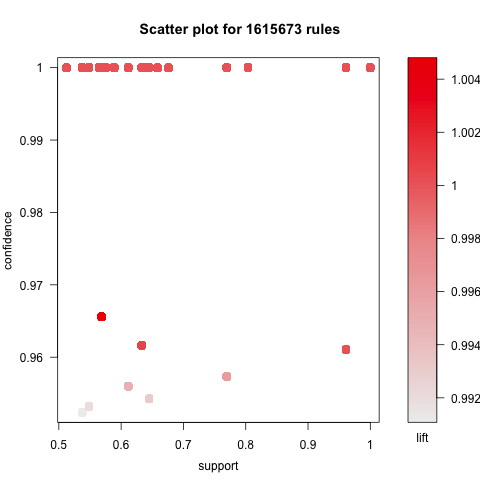

In [10]:

# visualize the different rules, 
#  the first visualization might take some time to render properly
%R library(arulesViz)
%R plot(rules)

In [ ]:

# a great plot
%R plot(rules, method="grouped")
%R inspect(rules)
%R length(rules)

## Summarize the Ramifications

# 4. Deployment

# 5. Exceptional Work